<table>
    <tr>
        <td>
            <img src="./image/price_momentum_strategy.png" alt="图片描述">
        </td>
    </tr>
    <tr>
        <td>
            <img src="./image/price_momentum_strategy_1.png" alt="图片描述">
        </td>
    </tr>
    <tr>
        <td>
            <img src="./image/price_momentum_strategy_2.png" alt="图片描述">
        </td>
    </tr>
</table>

策略逻辑说明

动量策略是一个常见的策略类型，包括绝对动量和相对动量。绝对动量是指在时间序列上，如果过去一段时间的收益率为正，那么就持有多头；如果过去一段时间的收益率为负数，那么就持有空头。相对动量，是分析过去一段时间中，多个股票上的收益率，做多收益率最高的一组；做空收益率最低的一组。这个策略使用的是相对动量策略。

和前几个策略的资金、资金分配、交易手续费都是一样的，不一样的是开平仓信号。

我们使用全市场的A股日data_folder进行测试，做多头，也做空头。多头和空头都占用资金。

假设初始资金有1个亿，手续费为万分之二。

首先，计算过去60个交易日股票的累计收益率，根据累计收益率的高低，把股票分为10组，做多收益率高的一组，做空收益率低的一组。资金在各个股票之间等权重分配。缺点在于忽略停牌的交易日，比如，这只股票在过去30天停牌了，计算累计收益率的时候，依然是计算过去的有bar的60个交易日。

加载data_folder完毕
2005-01-04, total_value : 100000000.0
2005-01-05, total_value : 100000000.0
2005-01-06, total_value : 100000000.0
2005-01-07, total_value : 100000000.0
2005-01-10, total_value : 100000000.0
2005-01-11, total_value : 100000000.0
2005-01-12, total_value : 100000000.0
2005-01-13, total_value : 100000000.0
2005-01-14, total_value : 100000000.0
2005-01-17, total_value : 100000000.0
2005-01-18, total_value : 100000000.0
2005-01-19, total_value : 100000000.0
2005-01-20, total_value : 100000000.0
2005-01-21, total_value : 100000000.0
2005-01-24, total_value : 100000000.0
2005-01-25, total_value : 100000000.0
2005-01-26, total_value : 100000000.0
2005-01-27, total_value : 100000000.0
2005-01-28, total_value : 100000000.0
2005-01-31, total_value : 100000000.0
2005-02-01, total_value : 100000000.0
2005-02-02, total_value : 100000000.0
2005-02-03, total_value : 100000000.0
2005-02-04, total_value : 100000000.0
2005-02-16, total_value : 100000000.0
2005-02-17, total_value : 10000000

Worst drawdown periods,Net drawdown in %,Peak date,Valley date,Recovery date,Duration
0,78.95,2009-06-10,2013-02-07,NaT,NaN
1,34.60,2008-03-20,2009-03-09,2009-06-08,318
2,26.21,2006-05-15,2007-07-30,2007-08-27,336
3,13.84,2005-07-18,2005-12-23,2006-04-19,198
4,11.33,2008-03-11,2008-03-13,2008-03-18,6


Stress Events,mean,min,max
Lehman,0.03%,-1.68%,1.41%
US downgrade/European Debt Crisis,0.03%,-0.54%,0.76%
Fukushima,0.17%,-0.91%,0.84%
EZB IR Event,-0.09%,-0.68%,0.93%
Aug07,1.32%,-7.07%,36.70%
Mar08,3.35%,-6.08%,71.39%
Sept08,-0.08%,-1.68%,0.95%
2009Q1,-0.14%,-1.51%,0.70%
2009Q2,0.07%,-1.27%,1.14%
Flash Crash,-0.35%,-3.41%,1.74%


Top 10 long positions of all time,max
600401.XSHG,104.72%
000631.XSHE,101.24%
000156.XSHE,100.71%
600629.XSHG,95.86%
000529.XSHE,63.79%
000517.XSHE,42.23%
300268.XSHE,31.68%
600844.XSHG,14.34%
000578.XSHE,12.24%
601519.XSHG,9.77%


Top 10 short positions of all time,max
000403.XSHE,-458.35%
000681.XSHE,-210.19%
000578.XSHE,-125.24%
600556.XSHG,-97.26%
000686.XSHE,-95.71%
000751.XSHE,-27.97%
600385.XSHG,-25.14%
000718.XSHE,-18.98%
600678.XSHG,-17.13%
000557.XSHE,-16.59%


Top 10 positions of all time,max
000403.XSHE,458.35%
000681.XSHE,210.19%
000578.XSHE,125.24%
600401.XSHG,104.72%
000631.XSHE,101.24%
000156.XSHE,100.71%
600556.XSHG,97.26%
600629.XSHG,95.86%
000686.XSHE,95.71%
000529.XSHE,63.79%


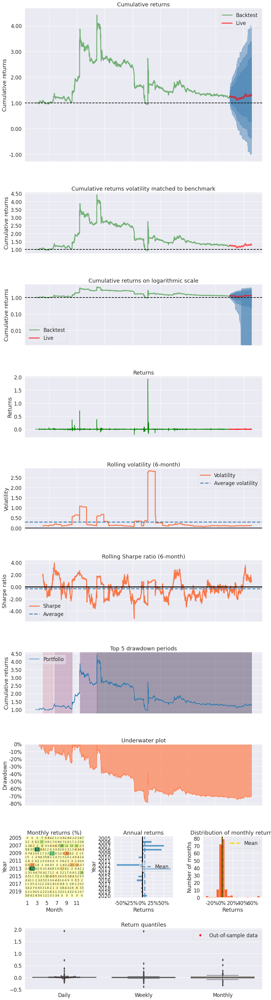

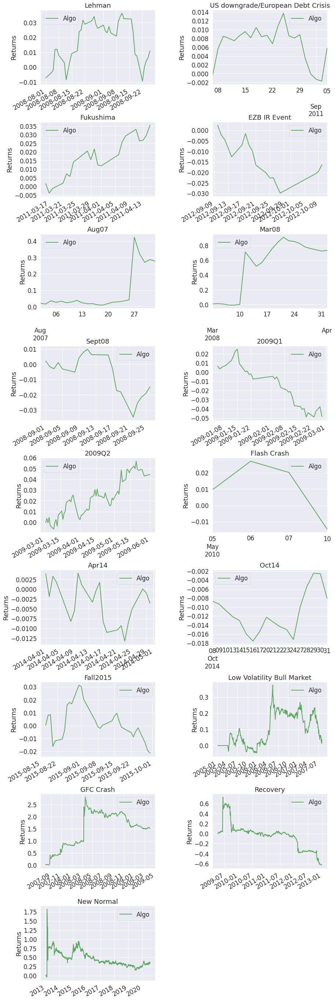

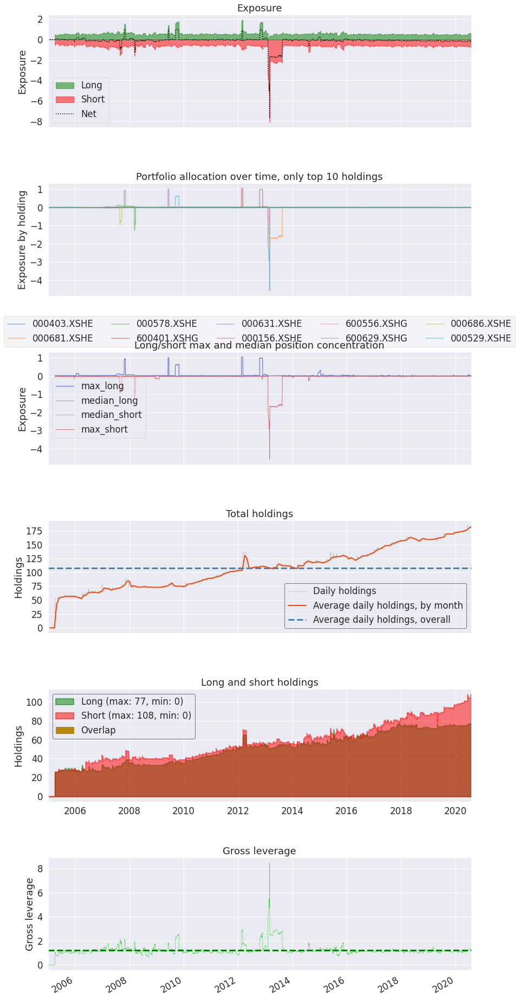

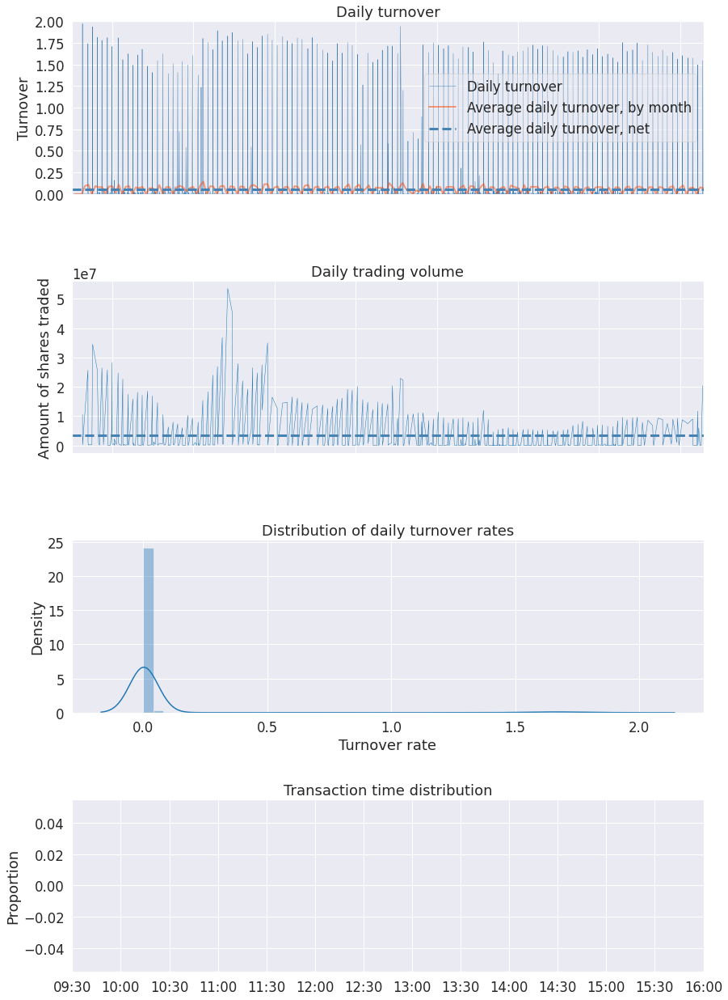

In [1]:
import backtesting as bt
import datetime
import pandas as pd
import numpy as np
import os,sys
import copy
import talib
import math 
import warnings
warnings.filterwarnings("ignore")
import pyfolio as pf

# 我们使用的时候，直接用我们新的类读取data_folder就可以了。
class test_two_ma_strategy(bt.Strategy):
   
    params = (('period',30),
              ('hold_percent',0.02)
             )

    def log(self, txt, dt=None):
        ''' Logging function fot this strategy'''
        dt = dt or self.datas[0].datetime.date(0)
        print('{}, {}'.format(dt.isoformat(), txt))

    def __init__(self):
        # Keep a reference to the "close" line in the data[0] dataseries
        self.bar_num=0    
        # 保存现有持仓的股票
        self.position_dict={}
        # 当前有交易的股票
        self.stock_dict={}
        
       
    def prenext(self):

        self.next()
        
        
    def next(self):
        # 假设有100万资金，每次成份股调整，每个股票使用1万元
        self.bar_num+=1
        # 前一交易日和当前的交易日
        pre_date = self.datas[0].datetime.date(-1).strftime("%Y-%m-%d")
        current_date = self.datas[0].datetime.date(0).strftime("%Y-%m-%d")
        # 总的价值
        total_value = self.broker.get_value()
        total_cash  = self.broker.get_cash()
        self.log(f"total_value : {total_value}")
        # 第一个data_folder是指数，校正时间使用，不能用于交易
        # 循环所有的股票,计算股票的数目
        for data in self.datas[1:]:
            data_date = data.datetime.date(0).strftime("%Y-%m-%d")
            # 如果两个日期相等，说明股票在交易
            if current_date == data_date:
                stock_name = data._name
                if stock_name not in self.stock_dict:
                    self.stock_dict[stock_name]=1
        total_target_stock_num = len(self.stock_dict)
        # 现在持仓的股票数目
        total_holding_stock_num = len(self.position_dict)
        # 计算理论上的手数
        now_value = total_value/int(total_target_stock_num*self.p.hold_percent*2)
        # 如果今天是调仓日
        if self.bar_num%self.p.period == 0:
            
            # 循环股票，平掉所有的股票，计算现在可以交易的股票的累计收益率
            result = []
            for data in self.datas[1:]:
                data_date = data.datetime.date(0).strftime("%Y-%m-%d")
                size = self.getposition(data).size
                # 如果有仓位
                if size!=0:
                    self.close(data)
                    if data._name in self.position_dict:
                        self.position_dict.pop(data._name)
                        
                # 已经下单，但是订单没有成交
                if data._name in self.position_dict and size==0:
                    order = self.position_dict[data._name]
                    self.cancel(order)
                    self.position_dict.pop(data._name) 
                # 如果两个日期相等，说明股票在交易,就计算收益率，进行排序
                if current_date == data_date:
                    close_info = data.close
                    if len(close_info)>self.p.period:
                        now_close = close_info[0]
                        pre_close = close_info[-self.p.period+1]
                        cumsum_rate = (now_close - pre_close)/pre_close
                        result.append([data,cumsum_rate])
            # 根据计算出来的累计收益率进行排序，选出前10%的股票做多，后10%的股票做空
            new_result = sorted(result,key=lambda x:x[1])
            num = int(self.p.hold_percent * total_target_stock_num)
            sell_list = new_result[:num]
            buy_list = new_result[-num:]
            # 根据计算出来的信号，买卖相应的股票
            for data,cumsum_rate in buy_list:
                lots = now_value/data.close[0]
                lots = int(lots/100)*100 # 计算能下的手数，取整数
                order = self.buy(data,size = lots)
                self.position_dict[data._name] = order
            for data,cumsum_rate in sell_list:
                lots = now_value/data.close[0]
                lots = int(lots/100)*100 # 计算能下的手数，取整数
                order = self.sell(data,size = lots)
                self.position_dict[data._name] = order
                
                
                        
        
    def notify_order(self, order):
        
        if order.status in [order.Submitted, order.Accepted]:
            return
        
        if order.status == order.Rejected:
            self.log(f"Rejected : order_ref:{order.ref}  data_name:{order.p.data._name}")
            
        if order.status == order.Margin:
            self.log(f"Margin : order_ref:{order.ref}  data_name:{order.p.data._name}")
            
        if order.status == order.Cancelled:
            self.log(f"Concelled : order_ref:{order.ref}  data_name:{order.p.data._name}")
            
        if order.status == order.Partial:
            self.log(f"Partial : order_ref:{order.ref}  data_name:{order.p.data._name}")
         
        if order.status == order.Completed:
            if order.isbuy():
                self.log(f" BUY : data_name:{order.p.data._name} price : {order.executed.price} , cost : {order.executed.value} , commission : {order.executed.comm}")

            else:  # Sell
                self.log(f" SELL : data_name:{order.p.data._name} price : {order.executed.price} , cost : {order.executed.value} , commission : {order.executed.comm}")
    
    def notify_trade(self, trade):
        # 一个trade结束的时候输出信息
        if trade.isclosed:
            self.log('closed symbol is : {} , total_profit : {} , net_profit : {}' .format(
                            trade.getdataname(),trade.pnl, trade.pnlcomm))
            # self.trade_list.append([self.datas[0].datetime.date(0),trade.getdataname(),trade.pnl,trade.pnlcomm])
            
        if trade.isopen:
            self.log('open symbol is : {} , price : {} ' .format(
                            trade.getdataname(),trade.price))
    def stop(self):
        
        pass 
                
        
# 初始化cerebro,获得一个实例
cerebro = bt.Cerebro()
# cerebro.broker = bt.brokers.BackBroker(shortcash=True)  # 0.5%
data_root = "./stock/day/"
file_list =sorted(os.listdir(data_root))
params=dict(
    
    fromdate = datetime.datetime(2005,1,4),
    todate = datetime.datetime(2020,7,31),
    timeframe = bt.TimeFrame.Days,
    dtformat = ("%Y-%m-%d"),
    compression = 1,
    datetime = 0,
    open = 1,
    high = 2,
    low =3,
    close =4,
    volume =5,
    openinterest=-1)

# 加载指数data_folder
feed = bt.feeds.GenericCSVData(dataname = "./stock/index.csv",**params)
# 添加data_folder到cerebro
cerebro.adddata(feed, name = 'index')

# 读取data_folder
for file in file_list:
    #剔除不满一年的股票
    if len(pd.read_csv(data_root+file))<252:
        continue
    feed = bt.feeds.GenericCSVData(dataname = data_root+file,**params)
    # 添加data_folder到cerebro
    cerebro.adddata(feed, name = file[:-4])
print("加载data_folder完毕")
# 添加手续费，按照万分之二收取
cerebro.broker.setcommission(commission=0.0002,stocklike=True)
# 设置初始资金为1亿
cerebro.broker.setcash(1_0000_0000)
# 添加策略
cerebro.addstrategy(test_two_ma_strategy)
cerebro.addanalyzer(bt.analyzers.TotalValue, _name='_TotalValue')
cerebro.addanalyzer(bt.analyzers.PyFolio)
# 运行回测
results = cerebro.run()
# 打印相关信息
pyfoliozer = results[0].analyzers.getbyname('pyfolio')
returns, positions, transactions, gross_lev = pyfoliozer.get_pf_items()
pf.create_full_tear_sheet(
    returns,
    positions=positions,
    transactions=transactions,
    # gross_lev=gross_lev,
    live_start_date='2019-01-01',
    )

![图片描述](./image/return_momentum_strategy.png)

从优矿上获取了股票的每个季度的每股财务指标，我们使用每股营业利润作为earings的代表，但是由于这个财务指标公布日期不知道，只知道统计截止日期每季度结束的日期，所以，在使用这些data_folder的时候，有可能存在利用未来data_folder的可能性，有可能会造成收益率虚高。

策略逻辑说明

相对于原先的价格动量策略，收益动量策略的唯一区别就是不在使用过去的收益率进行排序了，而是使用SUE指标进行排序。SUE通过计算现在的收益与四个季度前的收益的差值除以过去八个季度的收益的标准差。做多SUE高的一部分股票，做空SUE低的一部分股票。

和前几个策略的资金、资金分配、交易手续费都是一样的。

我们使用全市场的A股日data_folder进行测试，做多头，也做空头。多头和空头都占用资金。

假设初始资金有1个亿，手续费为万分之二。

在实际的测试中，如果可以得到财务报表的发布日期，使用发布日期，避免使用未来data_folder。由于暂时没有得到data_folder的发布日期，在本次测试中，暂时忽略这个。

策略评价

作为一个多空中性策略(long-short equity),这个收益动量因子能够达到每年收益率13%,夏普率接近1.7的水平，总体上挺不错的。但是考虑到回测使用的每股营业利润的data_folder没有公布日期，我们回测的时候可能存在使用未来data_folder的现象，造成策略的绩效虚高。实际使用当中，尤其是利用财务data_folder的时候，一定要注意，在当前，能够直接拿到的有哪些data_folder，不能使用未来data_folder

加载data_folder完毕
2009-01-05, total_value : 100000000.0
2009-01-06, total_value : 100000000.0
2009-01-07, total_value : 100000000.0
2009-01-08, total_value : 100000000.0
2009-01-09, total_value : 100000000.0
2009-01-12, total_value : 100000000.0
2009-01-13, total_value : 100000000.0
2009-01-14, total_value : 100000000.0
2009-01-15, total_value : 100000000.0
2009-01-16, total_value : 100000000.0
2009-01-19, total_value : 100000000.0
2009-01-20, total_value : 100000000.0
2009-01-21, total_value : 100000000.0
2009-01-22, total_value : 100000000.0
2009-01-23, total_value : 100000000.0
2009-02-02, total_value : 100000000.0
2009-02-03, total_value : 100000000.0
2009-02-04, total_value : 100000000.0
2009-02-05, total_value : 100000000.0
2009-02-06, total_value : 100000000.0
2009-02-09, total_value : 100000000.0
2009-02-10, total_value : 100000000.0
2009-02-11, total_value : 100000000.0
2009-02-12, total_value : 100000000.0
2009-02-13, total_value : 100000000.0
2009-02-16, total_value : 10000000

Worst drawdown periods,Net drawdown in %,Peak date,Valley date,Recovery date,Duration
0,19.41,2014-02-10,2015-03-18,2016-03-02,538
1,9.99,2018-07-17,2019-03-07,2019-05-16,218
2,6.56,2012-12-11,2012-12-26,2013-01-31,38
3,5.20,2009-07-13,2009-08-04,2009-08-31,36
4,4.59,2009-10-16,2009-11-27,2010-04-30,141


Stress Events,mean,min,max
US downgrade/European Debt Crisis,0.68%,-1.16%,5.40%
Fukushima,0.01%,-0.65%,0.82%
EZB IR Event,0.02%,-0.23%,0.45%
2009Q1,0.00%,-1.11%,0.72%
2009Q2,0.12%,-0.74%,1.16%
Flash Crash,-0.29%,-0.51%,0.29%
Apr14,-0.12%,-1.05%,0.48%
Oct14,0.06%,-0.45%,0.48%
Fall2015,-0.02%,-0.54%,0.95%
GFC Crash,0.00%,-1.11%,0.81%


Top 10 long positions of all time,max
000751.XSHE,32.18%
000820.XSHE,20.47%
000722.XSHE,19.63%
000982.XSHE,19.24%
000594.XSHE,11.42%
600179.XSHG,10.38%
000818.XSHE,9.42%
300063.XSHE,9.08%
600250.XSHG,6.37%
600087.XSHG,6.30%


Top 10 short positions of all time,max
600057.XSHG,-56.23%
600145.XSHG,-17.62%
000982.XSHE,-17.37%
600061.XSHG,-9.24%
000547.XSHE,-5.76%
600212.XSHG,-4.64%
600876.XSHG,-4.42%
600318.XSHG,-4.32%
600239.XSHG,-4.08%
600849.XSHG,-4.05%


Top 10 positions of all time,max
600057.XSHG,56.23%
000751.XSHE,32.18%
000820.XSHE,20.47%
000722.XSHE,19.63%
000982.XSHE,19.24%
600145.XSHG,17.62%
000594.XSHE,11.42%
600179.XSHG,10.38%
000818.XSHE,9.42%
600061.XSHG,9.24%


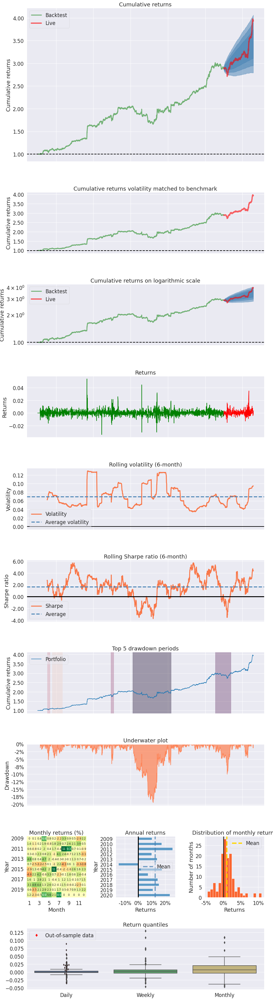

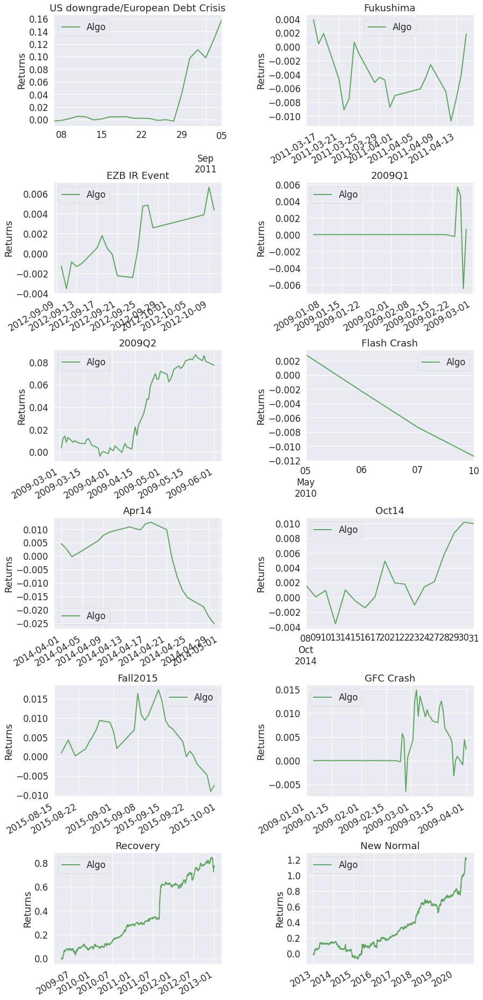

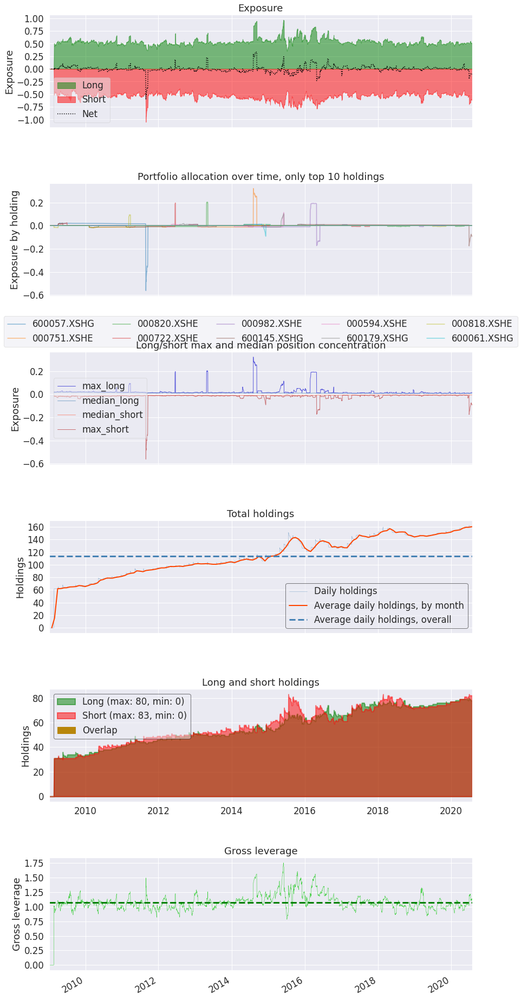

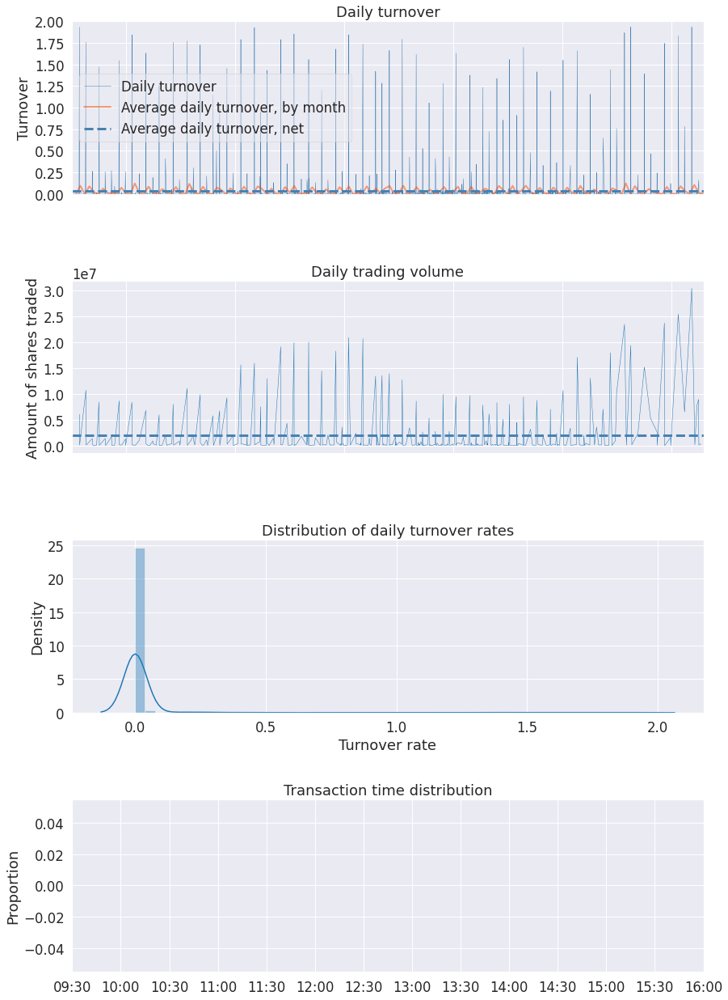

In [2]:
import backtesting as bt
import datetime
import pandas as pd
import numpy as np
import os,sys
import copy
import talib
import math 
import warnings
warnings.filterwarnings("ignore")
import pyfolio as pf

# 我们使用的时候，直接用我们新的类读取data_folder就可以了。
class test_two_ma_strategy(bt.Strategy):
   
    params = (('period',30),
              ('hold_percent',0.02)
             )

    def log(self, txt, dt=None):
        ''' Logging function fot this strategy'''
        dt = dt or self.datas[0].datetime.date(0)
        print('{}, {}'.format(dt.isoformat(), txt))

    def __init__(self):
        # Keep a reference to the "close" line in the data[0] dataseries
        self.bar_num=0    
        # 保存现有持仓的股票
        self.position_dict={}
        # 当前有交易的股票
        self.stock_dict={}
        # 加载每股收益的data_folder
        self.stock_info = pd.read_csv('./stock/每股财务指标data_folder/股票每股收益data_folder.csv')
        self.stock_info['endDate'] = pd.to_datetime(self.stock_info['endDate'])
       
    def prenext(self):
        
        self.next()
        
        
    def next(self):
        # 假设有100万资金，每次成份股调整，每个股票使用1万元
        self.bar_num+=1
        # 前一交易日和当前的交易日
        pre_date = self.datas[0].datetime.date(-1).strftime("%Y-%m-%d")
        current_date = self.datas[0].datetime.date(0).strftime("%Y-%m-%d")
        # 总的价值
        total_value = self.broker.get_value()
        total_cash  = self.broker.get_cash()
        self.log(f"total_value : {total_value}")
        # 第一个data_folder是指数，校正时间使用，不能用于交易
        # 循环所有的股票,计算股票的数目
        for data in self.datas[1:]:
            data_date = data.datetime.date(0).strftime("%Y-%m-%d")
            # 如果两个日期相等，说明股票在交易
            if current_date == data_date:
                stock_name = data._name
                if stock_name not in self.stock_dict:
                    self.stock_dict[stock_name]=1
        total_target_stock_num = len(self.stock_dict)
        # 现在持仓的股票数目
        total_holding_stock_num = len(self.position_dict)
        # 计算理论上的手数
        now_value = total_value/int(total_target_stock_num*self.p.hold_percent*2)
        # 如果今天是调仓日
        if self.bar_num%self.p.period == 0:
            
            # 循环股票，平掉所有的股票，计算现在可以交易的股票的累计收益率
            result = []
            for data in self.datas[1:]:
                    data_date = data.datetime.date(0).strftime("%Y-%m-%d")
                    size = self.getposition(data).size
                    # 如果有仓位
                    if size!=0:
                        self.close(data)
                        if data._name in self.position_dict:
                            self.position_dict.pop(data._name)

                    # 已经下单，但是订单没有成交
                    if data._name in self.position_dict and size==0:
                        order = self.position_dict[data._name]
                        self.cancel(order)
                        self.position_dict.pop(data._name) 
                    # 如果两个日期相等，说明股票在交易,就计算收益率，进行排序
                    if current_date == data_date:
                        new_stock_info = self.stock_info[self.stock_info['secID']==data._name]
                        new_stock_info = new_stock_info[new_stock_info['endDate']<=pd.to_datetime(current_date)]
                        new_stock_info = new_stock_info.sort_values('endDate')
                        # print(current_date,data._name,new_stock_info)
                        if len(new_stock_info)>=8:
                            opps = list(new_stock_info['opPS'])
                            sue = (opps[-1]-opps[-4])/np.std(opps[-8:])
                            # self.log(f"{data._name},{sue}")
                            result.append([data,sue])
            # 根据计算出来的累计收益率进行排序，选出前10%的股票做多，后10%的股票做空
            new_result = sorted(result,key=lambda x:x[1])
            num = int(self.p.hold_percent * total_target_stock_num)
            sell_list = new_result[:num]
            buy_list = new_result[-num:]
            # 根据计算出来的信号，买卖相应的股票
            for data,cumsum_rate in buy_list:
                lots = now_value/data.close[0]
                lots = int(lots/100)*100 # 计算能下的手数，取整数
                order = self.buy(data,size = lots)
                self.position_dict[data._name] = order
            for data,cumsum_rate in sell_list:
                lots = now_value/data.close[0]
                lots = int(lots/100)*100 # 计算能下的手数，取整数
                order = self.sell(data,size = lots)
                self.position_dict[data._name] = order
                
                
                        
        
    def notify_order(self, order):
        
        if order.status in [order.Submitted, order.Accepted]:
            return
        
        if order.status == order.Rejected:
            self.log(f"Rejected : order_ref:{order.ref}  data_name:{order.p.data._name}")
            
        if order.status == order.Margin:
            self.log(f"Margin : order_ref:{order.ref}  data_name:{order.p.data._name}")
            
        if order.status == order.Cancelled:
            self.log(f"Concelled : order_ref:{order.ref}  data_name:{order.p.data._name}")
            
        if order.status == order.Partial:
            self.log(f"Partial : order_ref:{order.ref}  data_name:{order.p.data._name}")
         
        if order.status == order.Completed:
            if order.isbuy():
                self.log(f" BUY : data_name:{order.p.data._name} price : {order.executed.price} , cost : {order.executed.value} , commission : {order.executed.comm}")

            else:  # Sell
                self.log(f" SELL : data_name:{order.p.data._name} price : {order.executed.price} , cost : {order.executed.value} , commission : {order.executed.comm}")
    
    def notify_trade(self, trade):
        # 一个trade结束的时候输出信息
        if trade.isclosed:
            self.log('closed symbol is : {} , total_profit : {} , net_profit : {}' .format(
                            trade.getdataname(),trade.pnl, trade.pnlcomm))
            # self.trade_list.append([self.datas[0].datetime.date(0),trade.getdataname(),trade.pnl,trade.pnlcomm])
            
        if trade.isopen:
            self.log('open symbol is : {} , price : {} ' .format(
                            trade.getdataname(),trade.price))
    def stop(self):
        
        pass 
                
        
# 初始化cerebro,获得一个实例
cerebro = bt.Cerebro()
# cerebro.broker = bt.brokers.BackBroker(shortcash=True)  # 0.5%
data_root = "./stock/day/"
file_list =sorted(os.listdir(data_root))
params=dict(
    
    fromdate = datetime.datetime(2009,1,4),
    todate = datetime.datetime(2020,7,31),
    timeframe = bt.TimeFrame.Days,
    dtformat = ("%Y-%m-%d"),
    # compression = 1,
    datetime = 0,
    open = 1,
    high = 2,
    low =3,
    close =4,
    volume =5,
    openinterest=-1)

# 加载指数data_folder
df = pd.read_csv("./stock/index.csv")
df.columns = ['datetime','open','high','low','close','volume','openinterest']
df.index = pd.to_datetime(df['datetime'])
df = df[['open','high','low','close','volume','openinterest']]
df = df[(df.index<=params['todate'])&(df.index>=params['fromdate'])]
feed = bt.feeds.PandasDirectData(dataname = df)
# 添加data_folder到cerebro
cerebro.adddata(feed, name = 'index')

# 读取data_folder
for file in file_list:
    df = pd.read_csv(data_root+file)
    df.columns = ['datetime','open','high','low','close','volume','openinterest']
    df.index = pd.to_datetime(df['datetime'])
    df = df[['open','high','low','close','volume','openinterest']]
    df = df[(df.index<=params['todate'])&(df.index>=params['fromdate'])]
    if len(df)==0:
        continue 
    feed = bt.feeds.PandasDirectData(dataname = df)
    # 添加data_folder到cerebro
    cerebro.adddata(feed, name = file[:-4])
print("加载data_folder完毕")
# 添加手续费，按照万分之二收取
cerebro.broker.setcommission(commission=0.0002,stocklike=True)
# 设置初始资金为1亿
cerebro.broker.setcash(1_0000_0000)
# 添加策略
cerebro.addstrategy(test_two_ma_strategy)
cerebro.addanalyzer(bt.analyzers.TotalValue, _name='_TotalValue')
cerebro.addanalyzer(bt.analyzers.PyFolio)
# 运行回测
results = cerebro.run()
# 打印相关信息
pyfoliozer = results[0].analyzers.getbyname('pyfolio')
returns, positions, transactions, gross_lev = pyfoliozer.get_pf_items()
pf.create_full_tear_sheet(
    returns,
    positions=positions,
    transactions=transactions,
    # gross_lev=gross_lev,
    live_start_date='2019-01-01',
    )

![图片描述](./image/value_momentum_strategy.png)

策略逻辑说明

相对于原先的收益动量策略，价值投资策略的思路唯一改变的地方就是选择股票的标准不一样，通过做多低P/B的一组股票，做空高P/B的一组股票，以期待获得相对稳定的收益率。

和前几个策略的资金、资金分配、交易手续费都是一样的。

我们使用全市场的A股日data_folder进行测试，做多头，也做空头。多头和空头都占用资金。

假设初始资金有1个亿，手续费为万分之二。

在实际的测试中，如果可以得到财务报表的发布日期，使用发布日期，避免使用未来data_folder。由于暂时没有得到data_folder的发布日期，在本次测试中，暂时忽略这个。

计算P/B使用的data_folder和上个策略获取的每股财务data_folder一样，用价格处以每股净资产，得到相应的P/B指标

策略简单分析

从策略的回测结果上来看，总体上是盈利的，但是表现没有收益动量因子好，这可能是因为PB是大家常用的用于衡量是否被高估低估的因子，造成这个因子的失效一些。并不能得出结论说，价值投资策略不如收益动量策略，这可能跟我们选择的因子有关。


加载data_folder完毕
2009-01-05, total_value : 100000000.0
2009-01-06, total_value : 100000000.0
2009-01-07, total_value : 100000000.0
2009-01-08, total_value : 100000000.0
2009-01-09, total_value : 100000000.0
2009-01-12, total_value : 100000000.0
2009-01-13, total_value : 100000000.0
2009-01-14, total_value : 100000000.0
2009-01-15, total_value : 100000000.0
2009-01-16, total_value : 100000000.0
2009-01-19, total_value : 100000000.0
2009-01-20, total_value : 100000000.0
2009-01-21, total_value : 100000000.0
2009-01-22, total_value : 100000000.0
2009-01-23, total_value : 100000000.0
2009-02-02, total_value : 100000000.0
2009-02-03, total_value : 100000000.0
2009-02-04, total_value : 100000000.0
2009-02-05, total_value : 100000000.0
2009-02-06, total_value : 100000000.0
2009-02-09, total_value : 100000000.0
2009-02-10, total_value : 100000000.0
2009-02-11, total_value : 100000000.0
2009-02-12, total_value : 100000000.0
2009-02-13, total_value : 100000000.0
2009-02-16, total_value : 10000000

Worst drawdown periods,Net drawdown in %,Peak date,Valley date,Recovery date,Duration
0,41.50,2012-12-04,2014-08-06,2015-12-24,798
1,26.12,2011-01-27,2011-08-18,2012-11-26,478
2,10.67,2019-07-04,2020-05-19,NaT,NaN
3,7.04,2009-11-24,2010-01-21,2010-05-14,124
4,5.65,2017-06-02,2017-07-07,2018-01-18,165


Stress Events,mean,min,max
US downgrade/European Debt Crisis,0.22%,-11.94%,8.71%
Fukushima,-0.19%,-0.74%,0.40%
EZB IR Event,-0.04%,-0.42%,0.60%
2009Q1,0.01%,-1.05%,0.71%
2009Q2,0.04%,-1.25%,1.43%
Flash Crash,0.15%,-0.32%,0.46%
Apr14,-0.00%,-0.46%,0.65%
Oct14,0.20%,-0.44%,1.26%
Fall2015,-0.06%,-1.41%,1.24%
GFC Crash,0.04%,-1.05%,1.36%


Top 10 long positions of all time,max
000831.XSHE,96.14%
000587.XSHE,67.19%
000722.XSHE,26.77%
000504.XSHE,8.70%
600768.XSHG,6.68%
000892.XSHE,5.84%
000677.XSHE,4.80%
600556.XSHG,4.57%
002803.XSHE,4.57%
600606.XSHG,4.38%


Top 10 short positions of all time,max
600817.XSHG,-125.91%
000520.XSHE,-106.73%
600057.XSHG,-77.86%
600556.XSHG,-63.00%
000751.XSHE,-57.37%
600372.XSHG,-38.88%
600870.XSHG,-27.62%
000035.XSHE,-25.63%
000545.XSHE,-24.79%
000030.XSHE,-23.95%


Top 10 positions of all time,max
600817.XSHG,125.91%
000520.XSHE,106.73%
000831.XSHE,96.14%
600057.XSHG,77.86%
000587.XSHE,67.19%
600556.XSHG,63.00%
000751.XSHE,57.37%
600372.XSHG,38.88%
600870.XSHG,27.62%
000722.XSHE,26.77%


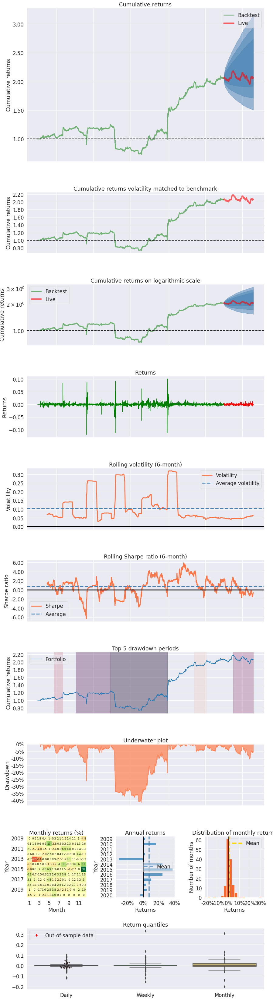

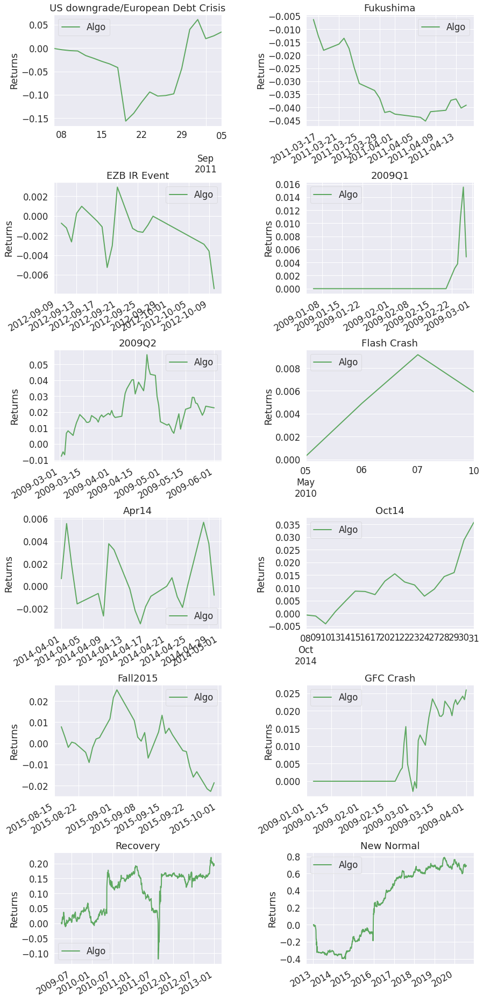

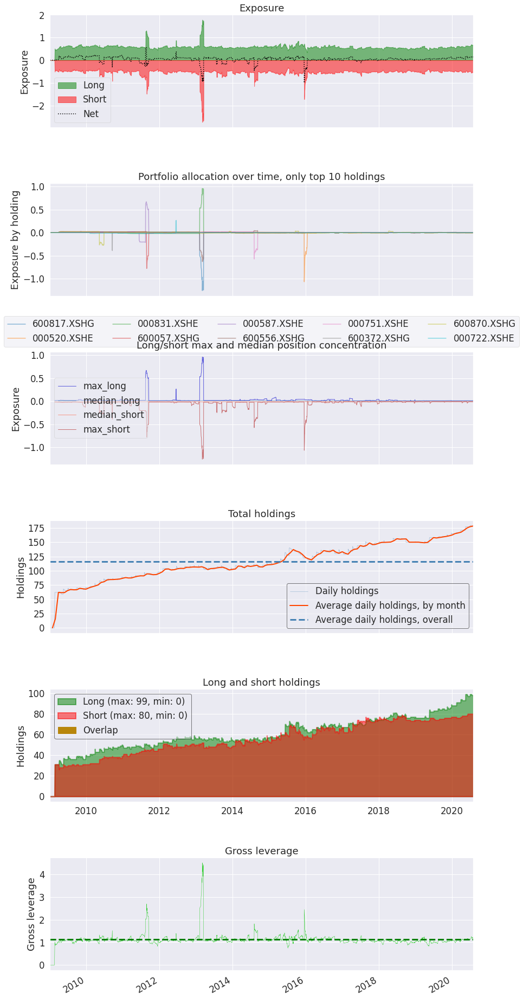

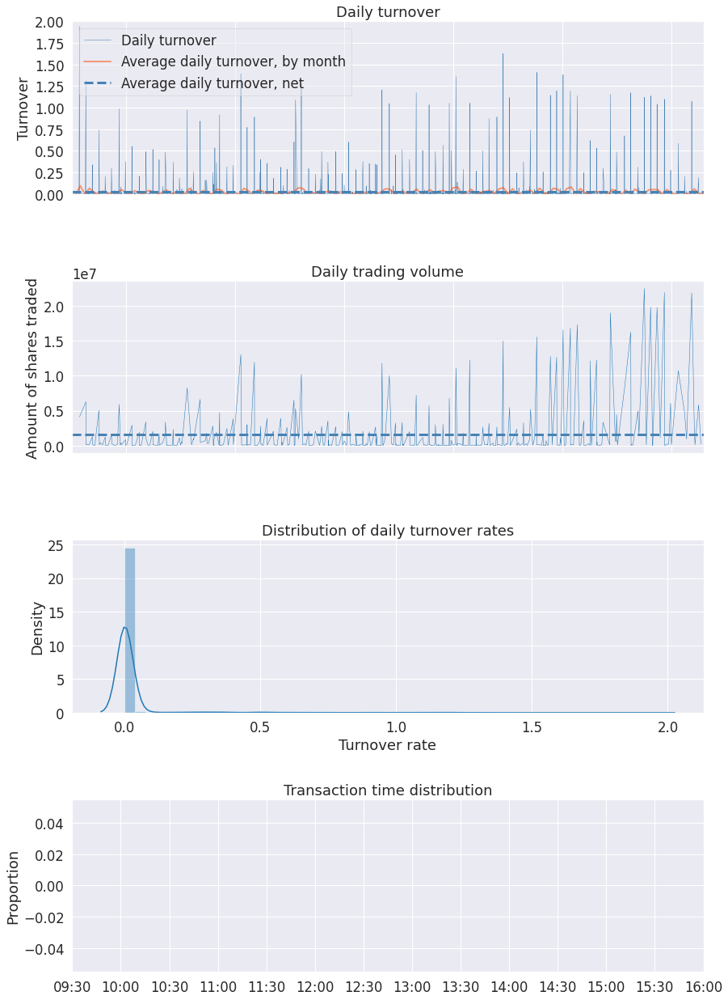

In [3]:
import backtesting as bt
import datetime
import pandas as pd
import numpy as np
import os,sys
import copy
import talib
import math 
import warnings
warnings.filterwarnings("ignore")
import pyfolio as pf

# 我们使用的时候，直接用我们新的类读取data_folder就可以了。
class test_two_ma_strategy(bt.Strategy):
   
    params = (('period',30),
              ('hold_percent',0.02)
             )

    def log(self, txt, dt=None):
        ''' Logging function fot this strategy'''
        dt = dt or self.datas[0].datetime.date(0)
        print('{}, {}'.format(dt.isoformat(), txt))

    def __init__(self):
        # Keep a reference to the "close" line in the data[0] dataseries
        self.bar_num=0    
        # 保存现有持仓的股票
        self.position_dict={}
        # 当前有交易的股票
        self.stock_dict={}
        # 加载每股收益的data_folder
        self.stock_info = pd.read_csv('./stock/每股财务指标data_folder/股票每股收益data_folder.csv')
        self.stock_info['endDate'] = pd.to_datetime(self.stock_info['endDate'])
       
    def prenext(self):
        
        self.next()
        
        
    def next(self):
        # 假设有100万资金，每次成份股调整，每个股票使用1万元
        self.bar_num+=1
        # 前一交易日和当前的交易日
        pre_date = self.datas[0].datetime.date(-1).strftime("%Y-%m-%d")
        current_date = self.datas[0].datetime.date(0).strftime("%Y-%m-%d")
        # 总的价值
        total_value = self.broker.get_value()
        total_cash  = self.broker.get_cash()
        self.log(f"total_value : {total_value}")
        # 第一个data_folder是指数，校正时间使用，不能用于交易
        # 循环所有的股票,计算股票的数目
        for data in self.datas[1:]:
            data_date = data.datetime.date(0).strftime("%Y-%m-%d")
            # 如果两个日期相等，说明股票在交易
            if current_date == data_date:
                stock_name = data._name
                if stock_name not in self.stock_dict:
                    self.stock_dict[stock_name]=1
        total_target_stock_num = len(self.stock_dict)
        # 现在持仓的股票数目
        total_holding_stock_num = len(self.position_dict)
        # 计算理论上的手数
        now_value = total_value/int(total_target_stock_num*self.p.hold_percent*2)
        # 如果今天是调仓日
        if self.bar_num%self.p.period == 0:
            
            # 循环股票，平掉所有的股票，计算现在可以交易的股票的累计收益率
            result = []
            for data in self.datas[1:]:
                    data_date = data.datetime.date(0).strftime("%Y-%m-%d")
                    size = self.getposition(data).size
                    # 如果有仓位
                    if size!=0:
                        self.close(data)
                        if data._name in self.position_dict:
                            self.position_dict.pop(data._name)

                    # 已经下单，但是订单没有成交
                    if data._name in self.position_dict and size==0:
                        order = self.position_dict[data._name]
                        self.cancel(order)
                        self.position_dict.pop(data._name) 
                    # 如果两个日期相等，说明股票在交易,就计算收益率，进行排序
                    if current_date == data_date:
                        new_stock_info = self.stock_info[self.stock_info['secID']==data._name]
                        new_stock_info = new_stock_info[new_stock_info['endDate']<=pd.to_datetime(current_date)]
                        new_stock_info = new_stock_info.sort_values('endDate')
                        # print(current_date,data._name,new_stock_info)
                        if len(new_stock_info)>=8:
                            opps = list(new_stock_info['nAssetPS'])
                            if opps[-1]!=0:
                                sue = data.close[0]/opps[-1]
                                # self.log(f"{data._name},{sue}")
                                result.append([data,sue])
            # 根据计算出来的累计收益率进行排序，选出前10%的股票做多，后10%的股票做空
            new_result = sorted(result,key=lambda x:x[1])
            num = int(self.p.hold_percent * total_target_stock_num)
            # 做多低pb的股票，做空高pb的股票
            buy_list = new_result[:num]
            sell_list = new_result[-num:]
            # 根据计算出来的信号，买卖相应的股票
            for data,cumsum_rate in buy_list:
                lots = now_value/data.close[0]
                lots = int(lots/100)*100 # 计算能下的手数，取整数
                order = self.buy(data,size = lots)
                self.position_dict[data._name] = order
            for data,cumsum_rate in sell_list:
                lots = now_value/data.close[0]
                lots = int(lots/100)*100 # 计算能下的手数，取整数
                order = self.sell(data,size = lots)
                self.position_dict[data._name] = order
                
                
                        
        
    def notify_order(self, order):
        
        if order.status in [order.Submitted, order.Accepted]:
            return
        
        if order.status == order.Rejected:
            self.log(f"Rejected : order_ref:{order.ref}  data_name:{order.p.data._name}")
            
        if order.status == order.Margin:
            self.log(f"Margin : order_ref:{order.ref}  data_name:{order.p.data._name}")
            
        if order.status == order.Cancelled:
            self.log(f"Concelled : order_ref:{order.ref}  data_name:{order.p.data._name}")
            
        if order.status == order.Partial:
            self.log(f"Partial : order_ref:{order.ref}  data_name:{order.p.data._name}")
         
        if order.status == order.Completed:
            if order.isbuy():
                self.log(f" BUY : data_name:{order.p.data._name} price : {order.executed.price} , cost : {order.executed.value} , commission : {order.executed.comm}")

            else:  # Sell
                self.log(f" SELL : data_name:{order.p.data._name} price : {order.executed.price} , cost : {order.executed.value} , commission : {order.executed.comm}")
    
    def notify_trade(self, trade):
        # 一个trade结束的时候输出信息
        if trade.isclosed:
            self.log('closed symbol is : {} , total_profit : {} , net_profit : {}' .format(
                            trade.getdataname(),trade.pnl, trade.pnlcomm))
            # self.trade_list.append([self.datas[0].datetime.date(0),trade.getdataname(),trade.pnl,trade.pnlcomm])
            
        if trade.isopen:
            self.log('open symbol is : {} , price : {} ' .format(
                            trade.getdataname(),trade.price))
    def stop(self):
        
        pass 
                
        
# 初始化cerebro,获得一个实例
cerebro = bt.Cerebro()
# cerebro.broker = bt.brokers.BackBroker(shortcash=True)  # 0.5%
data_root = "./stock/day/"
file_list =sorted(os.listdir(data_root))
params=dict(
    
    fromdate = datetime.datetime(2009,1,4),
    todate = datetime.datetime(2020,7,31),
    timeframe = bt.TimeFrame.Days,
    dtformat = ("%Y-%m-%d"),
    # compression = 1,
    datetime = 0,
    open = 1,
    high = 2,
    low =3,
    close =4,
    volume =5,
    openinterest=-1)

# 加载指数data_folder
df = pd.read_csv("./stock/index.csv")
df.columns = ['datetime','open','high','low','close','volume','openinterest']
df.index = pd.to_datetime(df['datetime'])
df = df[['open','high','low','close','volume','openinterest']]
df = df[(df.index<=params['todate'])&(df.index>=params['fromdate'])]
# feed = bt.feeds.GenericCSVData(dataname = "/home/yun/data/stock/index.csv",**params)
feed = bt.feeds.PandasDirectData(dataname = df)
# 添加data_folder到cerebro
cerebro.adddata(feed, name = 'index')

# 读取data_folder
for file in file_list:
    df = pd.read_csv(data_root+file)
    df.columns = ['datetime','open','high','low','close','volume','openinterest']
    df.index = pd.to_datetime(df['datetime'])
    df = df[['open','high','low','close','volume','openinterest']]
    df = df[(df.index<=params['todate'])&(df.index>=params['fromdate'])]
    if len(df)==0:
        continue 
    # feed = bt.feeds.GenericCSVData(dataname = data_root+file,**params)
    feed = bt.feeds.PandasDirectData(dataname = df)
    # 添加data_folder到cerebro
    cerebro.adddata(feed, name = file[:-4])
print("加载data_folder完毕")
# 添加手续费，按照万分之二收取
cerebro.broker.setcommission(commission=0.0002,stocklike=True)
# 设置初始资金为1亿
cerebro.broker.setcash(1_0000_0000)
# 添加策略
cerebro.addstrategy(test_two_ma_strategy)
cerebro.addanalyzer(bt.analyzers.TotalValue, _name='_TotalValue')
cerebro.addanalyzer(bt.analyzers.PyFolio)
# 运行回测
results = cerebro.run()
# 打印相关信息
pyfoliozer = results[0].analyzers.getbyname('pyfolio')
returns, positions, transactions, gross_lev = pyfoliozer.get_pf_items()
pf.create_full_tear_sheet(
    returns,
    positions=positions,
    transactions=transactions,
    # gross_lev=gross_lev,
    live_start_date='2019-01-01',
    )


![图片描述](./image/low_volatility_strategy.png)

策略逻辑说明

这个策略和前几个策略也非常相似，只是挑选股票的因子换成了波动率，计算过去半年的波动率，做多波动率比较低的一组股票，做空波动率比较高的一组股票。

和前几个策略的资金、资金分配、交易手续费都是一样的。

我们使用全市场的A股日data_folder进行测试，做多头，也做空头。多头和空头都占用资金。

假设初始资金有1个亿，手续费为万分之二。

策略简单评价

低波动率策略明显没有价值策略和收益动量策略好，但是，从这几个因子的走势来看，低波动率策略和收益动量策略，有比较明显的互补作用，多个因子组合，有可能获得更好的收益风险比。

另外，低波动率因子或者策略的绩效和回看周期和持有周期有关，不同的参数，带来的结果很可能不一样。

可以考虑对不同的参数进行优化，画出来不同参数的绩效，从中选择相对比较稳定的参数对。

加载data_folder完毕
2009-01-05, total_value : 100000000.0
2009-01-06, total_value : 100000000.0
2009-01-07, total_value : 100000000.0
2009-01-08, total_value : 100000000.0
2009-01-09, total_value : 100000000.0
2009-01-12, total_value : 100000000.0
2009-01-13, total_value : 100000000.0
2009-01-14, total_value : 100000000.0
2009-01-15, total_value : 100000000.0
2009-01-16, total_value : 100000000.0
2009-01-19, total_value : 100000000.0
2009-01-20, total_value : 100000000.0
2009-01-21, total_value : 100000000.0
2009-01-22, total_value : 100000000.0
2009-01-23, total_value : 100000000.0
2009-02-02, total_value : 100000000.0
2009-02-03, total_value : 100000000.0
2009-02-04, total_value : 100000000.0
2009-02-05, total_value : 100000000.0
2009-02-06, total_value : 100000000.0
2009-02-09, total_value : 100000000.0
2009-02-10, total_value : 100000000.0
2009-02-11, total_value : 100000000.0
2009-02-12, total_value : 100000000.0
2009-02-13, total_value : 100000000.0
2009-02-16, total_value : 10000000

Worst drawdown periods,Net drawdown in %,Peak date,Valley date,Recovery date,Duration
0,29.29,2017-02-22,2020-07-10,NaT,NaN
1,27.19,2015-03-31,2015-05-27,2016-01-05,201
2,7.61,2009-07-13,2009-08-03,2009-10-19,71
3,7.00,2010-03-19,2010-06-10,2010-10-28,160
4,6.96,2011-10-24,2011-12-19,2012-11-26,286


Stress Events,mean,min,max
US downgrade/European Debt Crisis,-0.05%,-0.66%,0.73%
Fukushima,0.03%,-1.06%,0.55%
EZB IR Event,0.00%,-0.30%,0.27%
2009Q1,0.00%,0.00%,0.00%
2009Q2,0.00%,0.00%,0.00%
Flash Crash,0.22%,-0.18%,0.64%
Apr14,0.05%,-0.53%,0.54%
Oct14,0.16%,-0.52%,0.72%
Fall2015,0.22%,-1.16%,3.12%
GFC Crash,0.00%,0.00%,0.00%


Top 10 long positions of all time,max
002636.XSHE,5.48%
002682.XSHE,3.77%
002057.XSHE,3.56%
002673.XSHE,3.52%
002075.XSHE,3.43%
002593.XSHE,3.15%
002136.XSHE,2.86%
000011.XSHE,2.82%
000935.XSHE,2.73%
002079.XSHE,2.70%


Top 10 short positions of all time,max
000820.XSHE,-10.21%
603869.XSHG,-7.29%
603600.XSHG,-5.27%
603199.XSHG,-4.41%
603729.XSHG,-3.91%
603997.XSHG,-3.66%
603606.XSHG,-3.60%
603118.XSHG,-3.42%
300359.XSHE,-3.41%
603158.XSHG,-3.11%


Top 10 positions of all time,max
000820.XSHE,10.21%
603869.XSHG,7.29%
002636.XSHE,5.48%
603600.XSHG,5.27%
603199.XSHG,4.41%
603729.XSHG,3.91%
002682.XSHE,3.77%
603997.XSHG,3.66%
603606.XSHG,3.60%
002057.XSHE,3.56%


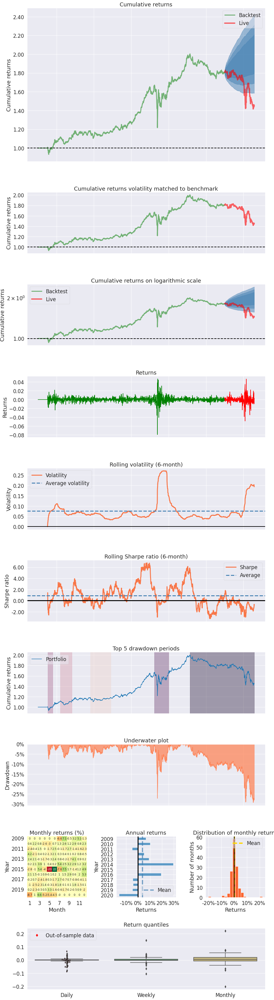

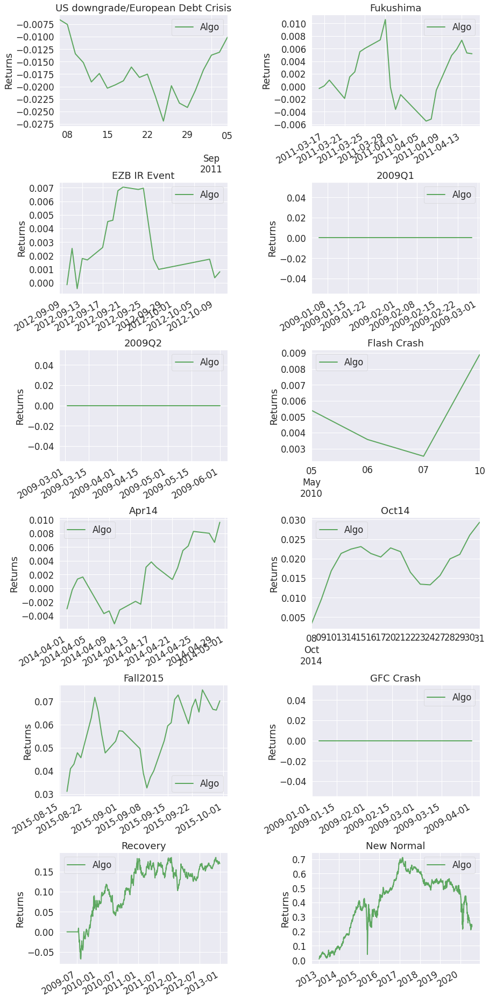

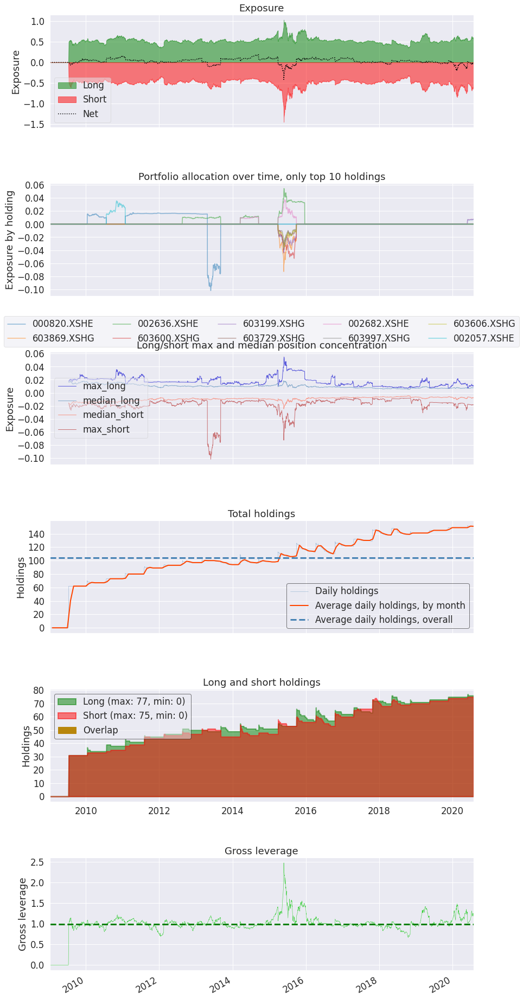

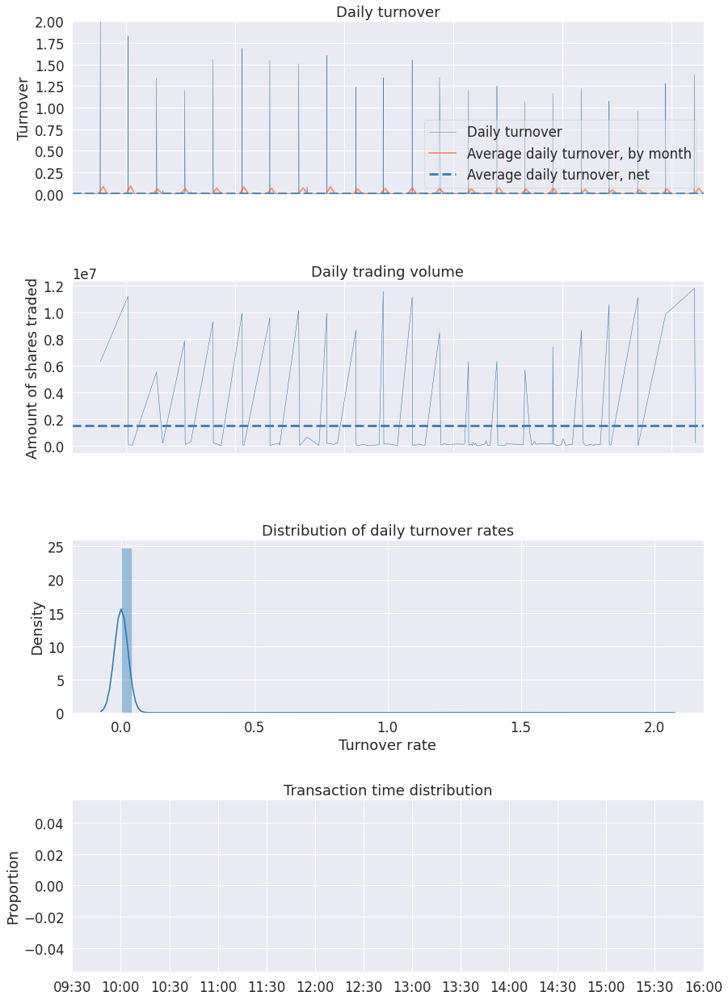

In [4]:
import backtesting as bt
import datetime
import pandas as pd
import numpy as np
import os,sys
import copy
import talib
import math 
import warnings
warnings.filterwarnings("ignore")
import pyfolio as pf

# 我们使用的时候，直接用我们新的类读取data_folder就可以了。
class test_two_ma_strategy(bt.Strategy):
   
    params = (('period',126),
              ('hold_percent',0.02)
             )

    def log(self, txt, dt=None):
        ''' Logging function fot this strategy'''
        dt = dt or self.datas[0].datetime.date(0)
        print('{}, {}'.format(dt.isoformat(), txt))

    def __init__(self):
        # Keep a reference to the "close" line in the data[0] dataseries
        self.bar_num=0    
        # 保存现有持仓的股票
        self.position_dict={}
        # 当前有交易的股票
        self.stock_dict={}
        # 计算波动率指标
        self.stock_std_dict = {data._name :bt.indicators.StandardDeviation(data.close,period = self.p.period) for data in self.datas[1:]}
       
    def prenext(self):
        
        self.next()
        
        
    def next(self):
        # 假设有100万资金，每次成份股调整，每个股票使用1万元
        self.bar_num+=1
        # 前一交易日和当前的交易日
        pre_date = self.datas[0].datetime.date(-1).strftime("%Y-%m-%d")
        current_date = self.datas[0].datetime.date(0).strftime("%Y-%m-%d")
        # 总的价值
        total_value = self.broker.get_value()
        total_cash  = self.broker.get_cash()
        self.log(f"total_value : {total_value}")
        # 第一个data_folder是指数，校正时间使用，不能用于交易
        # 循环所有的股票,计算股票的数目
        for data in self.datas[1:]:
            data_date = data.datetime.date(0).strftime("%Y-%m-%d")
            # 如果两个日期相等，说明股票在交易
            if current_date == data_date:
                stock_name = data._name
                if stock_name not in self.stock_dict:
                    self.stock_dict[stock_name]=1
        total_target_stock_num = len(self.stock_dict)
        # 现在持仓的股票数目
        total_holding_stock_num = len(self.position_dict)
        # 计算理论上的手数
        now_value = total_value/int(total_target_stock_num*self.p.hold_percent*2)
        # 如果今天是调仓日
        if self.bar_num%self.p.period == 0:
            
            # 循环股票，平掉所有的股票，计算现在可以交易的股票的累计收益率
            result = []
            for data in self.datas[1:]:
                    data_date = data.datetime.date(0).strftime("%Y-%m-%d")
                    size = self.getposition(data).size
                    # 如果有仓位
                    if size!=0:
                        self.close(data)
                        if data._name in self.position_dict:
                            self.position_dict.pop(data._name)

                    # 已经下单，但是订单没有成交
                    if data._name in self.position_dict and size==0:
                        order = self.position_dict[data._name]
                        self.cancel(order)
                        self.position_dict.pop(data._name) 
                    # 如果两个日期相等，说明股票在交易,就计算收益率，进行排序
                    if current_date == data_date:
                        sue = self.stock_std_dict[data._name][0]
                        result.append([data,sue])
            # 根据计算出来的累计收益率进行排序，选出前10%的股票做多，后10%的股票做空
            new_result = sorted(result,key=lambda x:x[1])
            num = int(self.p.hold_percent * total_target_stock_num)
            # 做多低pb的股票，做空高pb的股票
            buy_list = new_result[:num]
            sell_list = new_result[-num:]
            # 根据计算出来的信号，买卖相应的股票
            for data,cumsum_rate in buy_list:
                lots = now_value/data.close[0]
                lots = int(lots/100)*100 # 计算能下的手数，取整数
                order = self.buy(data,size = lots)
                self.position_dict[data._name] = order
            for data,cumsum_rate in sell_list:
                lots = now_value/data.close[0]
                lots = int(lots/100)*100 # 计算能下的手数，取整数
                order = self.sell(data,size = lots)
                self.position_dict[data._name] = order
                
                
                        
        
    def notify_order(self, order):
        
        if order.status in [order.Submitted, order.Accepted]:
            return
        
        if order.status == order.Rejected:
            self.log(f"Rejected : order_ref:{order.ref}  data_name:{order.p.data._name}")
            
        if order.status == order.Margin:
            self.log(f"Margin : order_ref:{order.ref}  data_name:{order.p.data._name}")
            
        if order.status == order.Cancelled:
            self.log(f"Concelled : order_ref:{order.ref}  data_name:{order.p.data._name}")
            
        if order.status == order.Partial:
            self.log(f"Partial : order_ref:{order.ref}  data_name:{order.p.data._name}")
         
        if order.status == order.Completed:
            if order.isbuy():
                self.log(f" BUY : data_name:{order.p.data._name} price : {order.executed.price} , cost : {order.executed.value} , commission : {order.executed.comm}")

            else:  # Sell
                self.log(f" SELL : data_name:{order.p.data._name} price : {order.executed.price} , cost : {order.executed.value} , commission : {order.executed.comm}")
    
    def notify_trade(self, trade):
        # 一个trade结束的时候输出信息
        if trade.isclosed:
            self.log('closed symbol is : {} , total_profit : {} , net_profit : {}' .format(
                            trade.getdataname(),trade.pnl, trade.pnlcomm))
            # self.trade_list.append([self.datas[0].datetime.date(0),trade.getdataname(),trade.pnl,trade.pnlcomm])
            
        if trade.isopen:
            self.log('open symbol is : {} , price : {} ' .format(
                            trade.getdataname(),trade.price))
    def stop(self):
        
        pass 
                
        
# 初始化cerebro,获得一个实例
cerebro = bt.Cerebro()
# cerebro.broker = bt.brokers.BackBroker(shortcash=True)  # 0.5%
data_root = "./stock/day/"
file_list =sorted(os.listdir(data_root))
params=dict(
    
    fromdate = datetime.datetime(2009,1,4),
    todate = datetime.datetime(2020,7,31),
    timeframe = bt.TimeFrame.Days,
    dtformat = ("%Y-%m-%d"),
    # compression = 1,
    datetime = 0,
    open = 1,
    high = 2,
    low =3,
    close =4,
    volume =5,
    openinterest=-1)

# 加载指数data_folder
df = pd.read_csv("./stock/index.csv")
df.columns = ['datetime','open','high','low','close','volume','openinterest']
df.index = pd.to_datetime(df['datetime'])
df = df[['open','high','low','close','volume','openinterest']]
df = df[(df.index<=params['todate'])&(df.index>=params['fromdate'])]
# feed = bt.feeds.GenericCSVData(dataname = "/home/yun/data/stock/index.csv",**params)
feed = bt.feeds.PandasDirectData(dataname = df)
# 添加data_folder到cerebro
cerebro.adddata(feed, name = 'index')

# 读取data_folder
for file in file_list:
    df = pd.read_csv(data_root+file)
    df.columns = ['datetime','open','high','low','close','volume','openinterest']
    df.index = pd.to_datetime(df['datetime'])
    df = df[['open','high','low','close','volume','openinterest']]
    df = df[(df.index<=params['todate'])&(df.index>=params['fromdate'])]
    if len(df)<=126:
        continue 
    # feed = bt.feeds.GenericCSVData(dataname = data_root+file,**params)
    feed = bt.feeds.PandasDirectData(dataname = df)
    # 添加data_folder到cerebro
    cerebro.adddata(feed, name = file[:-4])
print("加载data_folder完毕")
# 添加手续费，按照万分之二收取
cerebro.broker.setcommission(commission=0.0002,stocklike=True)
# 设置初始资金为1亿
cerebro.broker.setcash(1_0000_0000)
# 添加策略
cerebro.addstrategy(test_two_ma_strategy)
cerebro.addanalyzer(bt.analyzers.TotalValue, _name='_TotalValue')
cerebro.addanalyzer(bt.analyzers.PyFolio)
# 运行回测
results = cerebro.run()
# 打印相关信息
pyfoliozer = results[0].analyzers.getbyname('pyfolio')
returns, positions, transactions, gross_lev = pyfoliozer.get_pf_items()
pf.create_full_tear_sheet(
    returns,
    positions=positions,
    transactions=transactions,
    # gross_lev=gross_lev,
    live_start_date='2019-01-01',
    )


![图片描述](./image/momentum_value_factor_strategy.png)

策略逻辑说明

多因子策略主要涉及到两个问题：第一个问题如何组合因子选出来哪些股票进行交易；第二个问题是给每个策略分配多少资金；这可能也是对大多数策略来说，都挺关键的两个维度。

本文使用的因子组合方式是：

先选出来200支PE值最低的股票，作为被低估的股票，然后从这200支股票中，选出来100支过去半年(128天)收益率最高的股票作为动量较高的股票，把这100支股票做多；

先选出来200支PE值最高的股票，作为被高估的股票，然后从这200支股票中，选出来100支过去半年(128天)收益率最低的股票作为动量较低的股票，把这100支股票做空；

资金分配方式：

对每个股票平分资金；进一步的研究可以考虑根据波动率之类的，给每支股票分配不同的资金。

其他设置方式和以前的策略基本一样：

和前几个策略的资金、资金分配、交易手续费都是一样的。

我们使用全市场的A股日data_folder进行测试，做多头，也做空头。多头和空头都占用资金。

假设初始资金有1个亿，手续费为万分之二。

策略分析

很明显，这种因子组合方法，整体上的绩效并不好，也可能和参数有关系，也许把动量的周期改成一个月，效果会好上不少；

更进一步的方案，也可以考虑不同的因子组合方法，比如先选出动量的股票，然后从动量的股票中挑选出价值的股票，然后根据逻辑决定做多还是做空；

或者考虑使用打分法计算每只股票的分数，然后进行总体上的分数进行选择；

或者也可以考虑使用波动率等调整每支股票的仓位和使用的资金。

In [9]:
import backtesting as bt
import datetime
import pandas as pd
import numpy as np
import os,sys
import copy
import talib
import math 
import warnings
warnings.filterwarnings("ignore")
import pyfolio as pf

num=20
data_root = "./stock/day/"
file_list0 =sorted(os.listdir(data_root))
file_list=[i for i in file_list0[:num] if len(pd.read_csv(data_root+i))>126]
file_llist=[file[:-4] for file in file_list]
# 我们使用的时候，直接用我们新的类读取data_folder就可以了。
class TestMultiFactorStrategy(bt.Strategy):
   
    params = (('period',128),
             )

    def log(self, txt, dt=None):
        ''' Logging function fot this strategy'''
        dt = dt or self.datas[0].datetime.date(0)
        print('{}, {}'.format(dt.isoformat(), txt))

    def __init__(self):
        # Keep a reference to the "close" line in the data[0] dataseries
        self.bar_num=0    
        # 保存现有持仓的股票
        self.position_dict={}
        # 当前有交易的股票
        self.stock_dict={}
        # 加载pe_ratio的data_folder
        df = pd.read_csv("./stock/股票历史市值data_folder.csv",index_col=0)
        self.pe_ratio_info = df[df['secID'].isin(file_llist)]
        # self.pe_ratio_info = pd.read_csv("./stock/股票历史市值data_folder.csv")
        self.pe_ratio_info['day']=pd.to_datetime(self.pe_ratio_info['day'])
               
    def prenext(self):
        
        self.next()
        
        
    def next(self):
        # 假设有100万资金，每次成份股调整，每个股票使用1万元
        self.bar_num+=1
        # 前一交易日和当前的交易日
        pre_date = self.datas[0].datetime.date(-1).strftime("%Y-%m-%d")
        current_date = self.datas[0].datetime.date(0).strftime("%Y-%m-%d")
        # 总的价值
        total_value = self.broker.get_value()
        total_cash  = self.broker.get_cash()
        self.log(f"total_value : {total_value}")
        # 第一个data_folder是指数，校正时间使用，不能用于交易
        # 循环所有的股票,计算股票的数目
        for data in self.datas[1:]:
            data_date = data.datetime.date(0).strftime("%Y-%m-%d")
            # 如果两个日期相等，说明股票在交易
            if current_date == data_date:
                stock_name = data._name
                if stock_name not in self.stock_dict:
                    self.stock_dict[stock_name]=1
        total_target_stock_num = len(self.stock_dict)

        # 计算理论上的手数
        now_value = total_value/200
        # 如果今天是调仓日
        if self.bar_num%self.p.period == 0:
            
            # 循环股票，平掉所有的股票，计算现在可以交易的股票的累计收益率
            result = []
            for data in self.datas[1:]:
                    data_date = data.datetime.date(0).strftime("%Y-%m-%d")
                    size = self.getposition(data).size
                    # 如果有仓位
                    if size!=0:
                        self.close(data)
                        if data._name in self.position_dict:
                            self.position_dict.pop(data._name)

                    # 已经下单，但是订单没有成交
                    if data._name in self.position_dict and size==0:
                        order = self.position_dict[data._name]
                        self.cancel(order)
                        self.position_dict.pop(data._name) 
                    # 如果两个日期相等，说明股票在交易,就计算价格和pedata_folder
                    if current_date == data_date:
                        if len(data)>self.p.period:
                            # 计算动量的收益率
                            now_close = data.close[0]
                            pre_close = data.close[-self.p.period+1]
                            ret = (now_close-pre_close)/pre_close
                            # 获取pe指标
                            data_info = self.pe_ratio_info[self.pe_ratio_info['code']==data._name]
                            pe_ratio_list = list(data_info[data_info['day']==pd.to_datetime(current_date)]['pe_ratio'])
                            if len(pe_ratio_list)>0:
                                pe_ratio = pe_ratio_list[-1]
                            result.append([data,ret,pe_ratio])
                        
            # 根据计算出来data_folder进行排序，先选出来前200个pe最低，然后从中选出来100个动量最高的，做多
            new_result_pe = sorted(result,key=lambda x:x[2])
            new_result_pe_pb = sorted(new_result_pe[:200],key=lambda x:x[1])
            # 做多低pe的股票和高动量的股票
            buy_list = new_result_pe_pb[-100:]
            # 
            new_result_pe_pb = sorted(new_result_pe[-200:],key=lambda x:x[1])
            sell_list = new_result_pe_pb[:100]
            # 根据计算出来的信号，买卖相应的股票
            for data,cumsum_rate,_ in buy_list:
                lots = now_value/data.close[0]
                lots = int(lots/100)*100 # 计算能下的手数，取整数
                order = self.buy(data,size = lots)
                self.position_dict[data._name] = order
            for data,cumsum_rate,_ in sell_list:
                lots = now_value/data.close[0]
                lots = int(lots/100)*100 # 计算能下的手数，取整数
                order = self.sell(data,size = lots)
                self.position_dict[data._name] = order
                  
    def notify_order(self, order):
        
        if order.status in [order.Submitted, order.Accepted]:
            return
        
        if order.status == order.Rejected:
            self.log(f"Rejected : order_ref:{order.ref}  data_name:{order.p.data._name}")
            
        if order.status == order.Margin:
            self.log(f"Margin : order_ref:{order.ref}  data_name:{order.p.data._name}")
            
        if order.status == order.Cancelled:
            self.log(f"Concelled : order_ref:{order.ref}  data_name:{order.p.data._name}")
            
        if order.status == order.Partial:
            self.log(f"Partial : order_ref:{order.ref}  data_name:{order.p.data._name}")
         
        if order.status == order.Completed:
            if order.isbuy():
                self.log(f" BUY : data_name:{order.p.data._name} price : {order.executed.price} , cost : {order.executed.value} , commission : {order.executed.comm}")

            else:  # Sell
                self.log(f" SELL : data_name:{order.p.data._name} price : {order.executed.price} , cost : {order.executed.value} , commission : {order.executed.comm}")
    
    def notify_trade(self, trade):
        # 一个trade结束的时候输出信息
        if trade.isclosed:
            self.log('closed symbol is : {} , total_profit : {} , net_profit : {}' .format(
                            trade.getdataname(),trade.pnl, trade.pnlcomm))
            
        if trade.isopen:
            self.log('open symbol is : {} , price : {} ' .format(
                            trade.getdataname(),trade.price))
    def stop(self):
        
        pass 
                
        
# 初始化cerebro,获得一个实例
cerebro = bt.Cerebro()
# cerebro.broker = bt.brokers.BackBroker(shortcash=True)  # 0.5%

params=dict(
    
    fromdate = datetime.datetime(2005,1,4),
    todate = datetime.datetime(2020,7,31),
    timeframe = bt.TimeFrame.Days,
    dtformat = ("%Y-%m-%d"),
    # compression = 1,
    datetime = 0,
    open = 1,
    high = 2,
    low =3,
    close =4,
    volume =5,
    openinterest=-1)

# 加载指数data_folder
df = pd.read_csv("./stock/index.csv")
df.columns = ['datetime','open','high','low','close','volume','openinterest']
df.index = pd.to_datetime(df['datetime'])
df = df[['open','high','low','close','volume','openinterest']]
df = df[(df.index<=params['todate'])&(df.index>=params['fromdate'])]
# feed = bt.feeds.GenericCSVData(dataname = "/home/yun/data/stock/index.csv",**params)
feed = bt.feeds.PandasDirectData(dataname = df)
# 添加data_folder到cerebro
cerebro.adddata(feed, name = 'index')

# 读取data_folder
for file in file_list[:num]:
    df = pd.read_csv(data_root+file)
    df.columns = ['datetime','open','high','low','close','volume','openinterest']
    df.index = pd.to_datetime(df['datetime'])
    df = df[['open','high','low','close','volume','openinterest']]
    df = df[(df.index<=params['todate'])&(df.index>=params['fromdate'])]
    if len(df)<=126:
        continue 
    feed = bt.feeds.PandasDirectData(dataname = df)
    # 添加data_folder到cerebro
    cerebro.adddata(feed, name = file[:-4])
print("加载data_folder完毕")
# 添加手续费，按照万分之二收取
cerebro.broker.setcommission(commission=0.0002,stocklike=True)
# 设置初始资金为1亿
cerebro.broker.setcash(1_0000_0000)
# 添加策略
cerebro.addstrategy(TestMultiFactorStrategy)
cerebro.addanalyzer(bt.analyzers.TotalValue, _name='_TotalValue')
cerebro.addanalyzer(bt.analyzers.PyFolio)
# 运行回测
results = cerebro.run()
# 打印相关信息
pyfoliozer = results[0].analyzers.getbyname('pyfolio')
returns, positions, transactions, gross_lev = pyfoliozer.get_pf_items()
pf.create_full_tear_sheet(
    returns,
    positions=positions,
    transactions=transactions,
    # gross_lev=gross_lev,
    live_start_date='2019-01-01',
    )

![图片描述](./image/residual_return_momentum_strategy.png)

策略逻辑说明

这个策略和价格动量策略类似，只是一个用的价格的一阶差分(收益率)来衡量动量的大小，一个用的是贝塔因子、SMB、HML这三个因子不能解释的剩余收益率来衡量动量大小，做多动量高的，做空动量低的。

首先，从csmar上下载了每个交易日的三个因子的大小，然后使用过去一年的价格data_folder来计算收益率，用收益率代表y,三个因子代表x，进行回归，然后计算模型的残差，并计算风险调整后的剩余收益率，对所有股票的风险调整后的剩余收益率进行排序，做空低的10%的股票，做多高的10%的股票

其次，资金分配上，每支股票分配的金额是等额的(实际分配后比较接近，会有误差)

其他策略的设置和原先一样：我们使用全市场的A股日data_folder进行测试，做多头，也做空头。多头和空头都占用资金。假设初始资金有1个亿，手续费为万分之二。

策略简单分析

从策略带来的收益率上来看，策略在14年之后开始表现比较好，在09年到13年，表现都比较差；另外，总体上的收益率比较低，还不如购买理财产品呢；夏普率也比较低，都不到0.5；这个策略总体上不太好，需要进一步完善。

可以尝试用一下五因子看下策略的效果怎么样；或者单独使用一个因子，看下会不会效果比较好。

加载data_folder完毕
2009-01-05, total_value : 100000000.0
2009-01-06, total_value : 100000000.0
2009-01-07, total_value : 100000000.0
2009-01-08, total_value : 100000000.0
2009-01-09, total_value : 100000000.0
2009-01-12, total_value : 100000000.0
2009-01-13, total_value : 100000000.0
2009-01-14, total_value : 100000000.0
2009-01-15, total_value : 100000000.0
2009-01-16, total_value : 100000000.0
2009-01-19, total_value : 100000000.0
2009-01-20, total_value : 100000000.0
2009-01-21, total_value : 100000000.0
2009-01-22, total_value : 100000000.0
2009-01-23, total_value : 100000000.0
2009-02-02, total_value : 100000000.0
2009-02-03, total_value : 100000000.0
2009-02-04, total_value : 100000000.0
2009-02-05, total_value : 100000000.0
2009-02-06, total_value : 100000000.0
2009-02-09, total_value : 100000000.0
2009-02-10, total_value : 100000000.0
2009-02-11, total_value : 100000000.0
2009-02-12, total_value : 100000000.0
2009-02-13, total_value : 100000000.0
2009-02-16, total_value : 10000000

Worst drawdown periods,Net drawdown in %,Peak date,Valley date,Recovery date,Duration
0,9.81,2015-04-13,2015-12-18,2015-12-31,189
1,8.77,2012-01-19,2013-12-05,2015-01-23,787
2,7.20,2016-12-08,2018-02-06,2018-05-09,370
3,5.63,2010-08-05,2011-11-30,2012-01-18,380
4,5.34,2019-08-29,2020-07-06,NaT,NaN


Stress Events,mean,min,max
US downgrade/European Debt Crisis,-0.14%,-0.60%,0.48%
Fukushima,0.02%,-0.29%,0.43%
EZB IR Event,0.01%,-0.21%,0.35%
2009Q1,0.00%,0.00%,0.00%
2009Q2,0.00%,0.00%,0.00%
Flash Crash,-0.03%,-0.09%,0.09%
Apr14,-0.00%,-0.40%,0.64%
Oct14,0.05%,-0.48%,0.43%
Fall2015,-0.07%,-0.86%,0.76%
GFC Crash,0.00%,0.00%,0.00%


Top 10 long positions of all time,max
600817.XSHG,8.96%
300268.XSHE,7.52%
000545.XSHE,3.82%
600777.XSHG,3.50%
600701.XSHG,3.41%
000982.XSHE,3.13%
002044.XSHE,2.93%
002323.XSHE,2.58%
600381.XSHG,2.55%
000996.XSHE,2.03%


Top 10 short positions of all time,max
000520.XSHE,-23.66%
000030.XSHE,-6.23%
002075.XSHE,-4.38%
600687.XSHG,-3.73%
000982.XSHE,-3.52%
002464.XSHE,-3.31%
600816.XSHG,-2.75%
600485.XSHG,-2.63%
002492.XSHE,-2.37%
000629.XSHE,-2.26%


Top 10 positions of all time,max
000520.XSHE,23.66%
600817.XSHG,8.96%
300268.XSHE,7.52%
000030.XSHE,6.23%
002075.XSHE,4.38%
000545.XSHE,3.82%
600687.XSHG,3.73%
000982.XSHE,3.52%
600777.XSHG,3.50%
600701.XSHG,3.41%


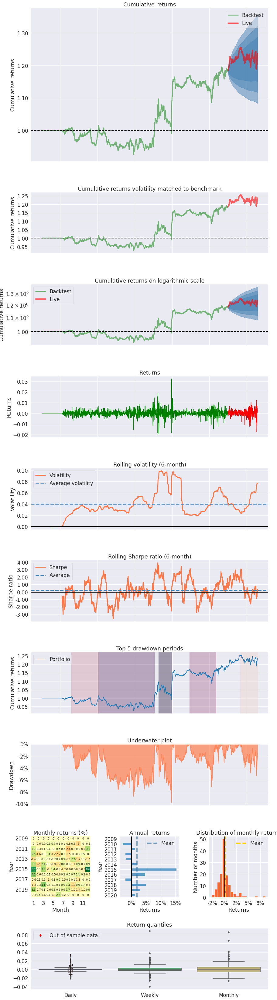

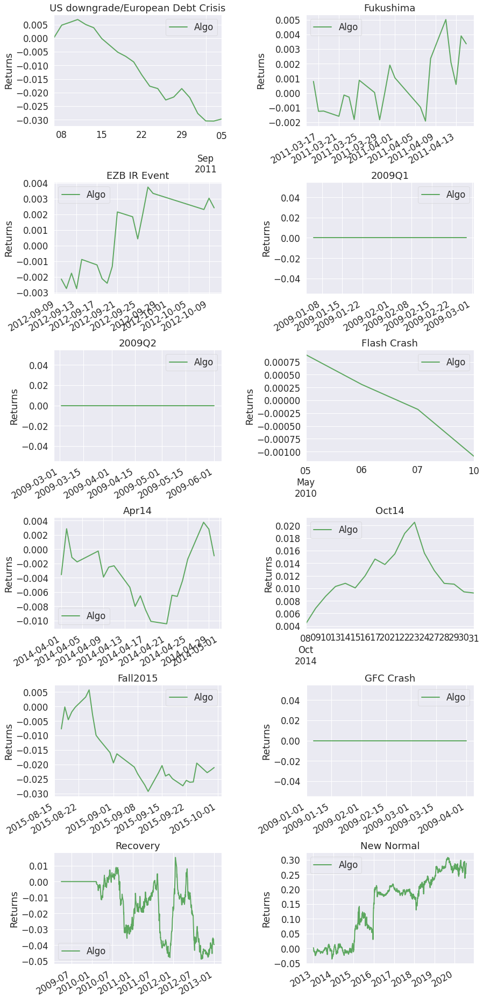

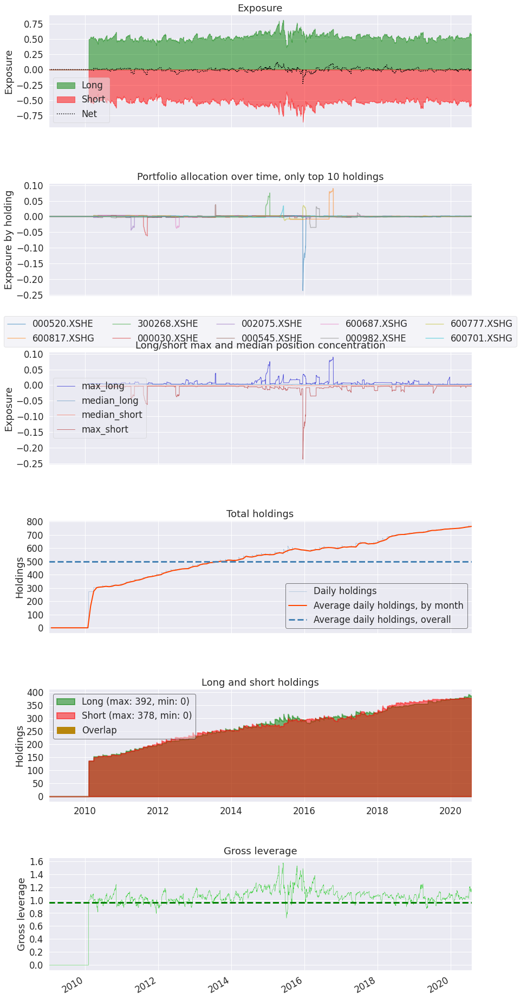

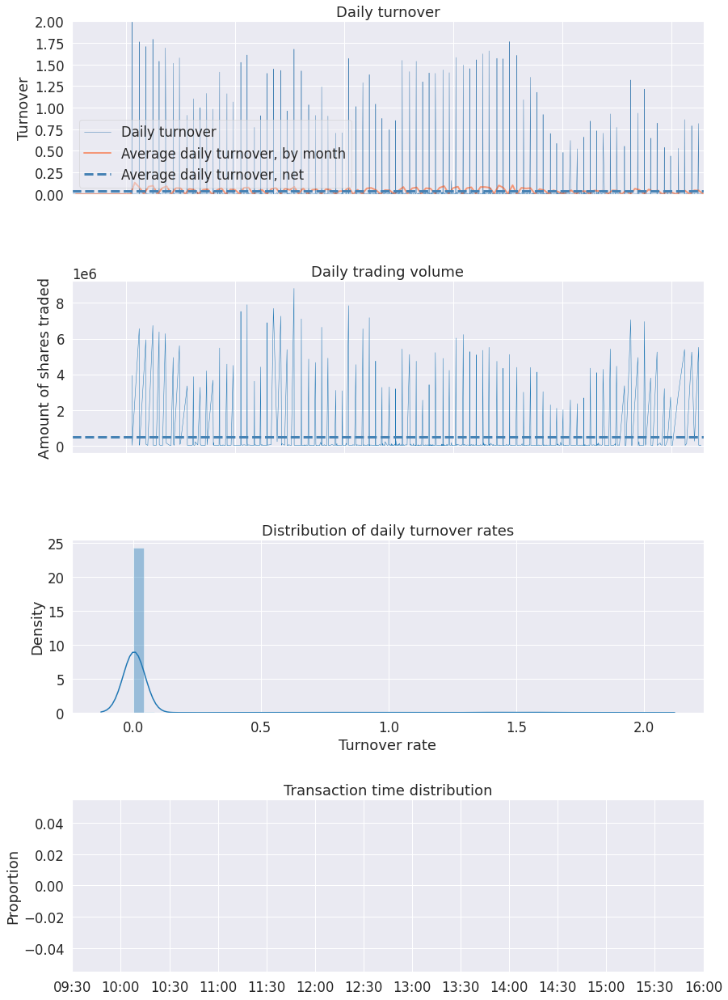

In [10]:
import backtesting as bt
import statsmodels.api as sm
import datetime
import pandas as pd
import numpy as np
import os,sys
import copy
import talib
import math 
import warnings
warnings.filterwarnings("ignore")
import pyfolio as pf

# 我们使用的时候，直接用我们新的类读取data_folder就可以了。
class test_two_ma_strategy(bt.Strategy):
   
    params = (('period',30),
              ('hold_percent',0.1)
             )

    def log(self, txt, dt=None):
        ''' Logging function fot this strategy'''
        dt = dt or self.datas[0].datetime.date(0)
        print('{}, {}'.format(dt.isoformat(), txt))

    def __init__(self):
        # Keep a reference to the "close" line in the data[0] dataseries
        self.bar_num=0    
        # 保存现有持仓的股票
        self.position_dict={}
        # 当前有交易的股票
        self.stock_dict={}
        # 加载法玛三因子data_folder
        df = pd.read_csv("./stock/三因子模型指标/STK_MKT_THRFACDAY.csv")
        df = df[df['MarkettypeID']=="P9709"]
        df.index=pd.to_datetime(df['TradingDate'])
        df = df[['RiskPremium1','SMB1','HML1']]
        self.df = df 
       
    def prenext(self):
        
        self.next()
        
        
    def next(self):
        # 假设有100万资金，每次成份股调整，每个股票使用1万元
        self.bar_num+=1
        # 前一交易日和当前的交易日
        pre_date = self.datas[0].datetime.date(-1).strftime("%Y-%m-%d")
        current_date = self.datas[0].datetime.date(0).strftime("%Y-%m-%d")
        # 总的价值
        total_value = self.broker.get_value()
        total_cash  = self.broker.get_cash()
        self.log(f"total_value : {total_value}")
        # 第一个data_folder是指数，校正时间使用，不能用于交易
        # 循环所有的股票,计算股票的数目
        for data in self.datas[1:]:
            # 上市不满一年的股票，忽略不计
            if len(data)>=252:
                data_date = data.datetime.date(0).strftime("%Y-%m-%d")
                # 如果两个日期相等，说明股票在交易
                if current_date == data_date:
                    stock_name = data._name
                    if stock_name not in self.stock_dict:
                        self.stock_dict[stock_name]=1
        # 如果入选的股票小于100支，不使用策略
        if len(self.stock_dict)<100:
            return 
        total_target_stock_num = len(self.stock_dict)
        # 现在持仓的股票数目
        total_holding_stock_num = len(self.position_dict)
        # 计算理论上的手数
        now_value = total_value/int(total_target_stock_num*self.p.hold_percent*2)
        # 如果今天是调仓日
        if self.bar_num%self.p.period == 0:
            
            # 循环股票，平掉所有的股票，计算现在可以交易的股票的累计收益率
            result = []
            for stock_name in self.stock_dict:
                data = self.getdatabyname(stock_name)
                data_date = data.datetime.date(0).strftime("%Y-%m-%d")
                size = self.getposition(data).size
                # 如果有仓位
                if size!=0:
                    self.close(data)
                    if data._name in self.position_dict:
                        self.position_dict.pop(data._name)

                # 已经下单，但是订单没有成交
                if data._name in self.position_dict and size==0:
                    order = self.position_dict[data._name]
                    self.cancel(order)
                    self.position_dict.pop(data._name) 
                # 如果两个日期相等，说明股票在交易,就计算收益率，进行排序
                if current_date == data_date:
                    # 计算股票的收益率,与三因子进行多元回归
                    date_close_list=[]
                    for i in range(252,0,-1):
                        date=data.datetime.date(-i).strftime("%Y-%m-%d")
                        close = data.close[-i]
                        date_close_list.append([date,close])
                    date_close_df = pd.DataFrame(date_close_list,columns=['date','close'])
                    date_close_df['rate']=(date_close_df['close']-date_close_df['close'].shift(1))/date_close_df['close'].shift(1)
                    date_close_df.index = pd.to_datetime(date_close_df['date'])
                    date_close_df = date_close_df.dropna()
                    date_close_df = date_close_df[['rate']]
                    # 把目标收益率的data_folder框和三因子进行合并
                    df = self.df
                    df = df[df.index<=pd.to_datetime(data_date)]
                    df = pd.concat([date_close_df,df],axis=1, join="inner")
                    # 进行多元回归
                    Y = df['rate']
                    X = df[['RiskPremium1','SMB1','HML1']]
                    X = sm.add_constant(X) # adding a constant
                    model = sm.OLS(Y, X).fit()
                    resid = model.resid
                    # 计算经过风险调整后的残差收益率
                    mean = np.mean(resid)
                    std = np.std(resid)
                    r_a = mean/std
                    result.append([data,r_a])
            # 根据计算出来的累计收益率进行排序，选出前10%的股票做多，后10%的股票做空
            new_result = sorted(result,key=lambda x:x[1])
            num = int(self.p.hold_percent * total_target_stock_num)
            sell_list = new_result[:num]
            buy_list = new_result[-num:]
            # 根据计算出来的信号，买卖相应的股票
            for data,cumsum_rate in buy_list:
                lots = now_value/data.close[0]
                lots = int(lots/100)*100 # 计算能下的手数，取整数
                order = self.buy(data,size = lots)
                self.position_dict[data._name] = order
            for data,cumsum_rate in sell_list:
                lots = now_value/data.close[0]
                lots = int(lots/100)*100 # 计算能下的手数，取整数
                order = self.sell(data,size = lots)
                self.position_dict[data._name] = order
                  
    def notify_order(self, order):
        
        if order.status in [order.Submitted, order.Accepted]:
            return
        
        if order.status == order.Rejected:
            self.log(f"Rejected : order_ref:{order.ref}  data_name:{order.p.data._name}")
            
        if order.status == order.Margin:
            self.log(f"Margin : order_ref:{order.ref}  data_name:{order.p.data._name}")
            
        if order.status == order.Cancelled:
            self.log(f"Concelled : order_ref:{order.ref}  data_name:{order.p.data._name}")
            
        if order.status == order.Partial:
            self.log(f"Partial : order_ref:{order.ref}  data_name:{order.p.data._name}")
         
        if order.status == order.Completed:
            if order.isbuy():
                self.log(f" BUY : data_name:{order.p.data._name} price : {order.executed.price} , cost : {order.executed.value} , commission : {order.executed.comm}")

            else:  # Sell
                self.log(f" SELL : data_name:{order.p.data._name} price : {order.executed.price} , cost : {order.executed.value} , commission : {order.executed.comm}")
    
    def notify_trade(self, trade):
        # 一个trade结束的时候输出信息
        if trade.isclosed:
            self.log('closed symbol is : {} , total_profit : {} , net_profit : {}' .format(
                            trade.getdataname(),trade.pnl, trade.pnlcomm))
            
        if trade.isopen:
            self.log('open symbol is : {} , price : {} ' .format(
                            trade.getdataname(),trade.price))
    def stop(self):
        
        pass 
                
        
# 初始化cerebro,获得一个实例
cerebro = bt.Cerebro()
# cerebro.broker = bt.brokers.BackBroker(shortcash=True)  # 0.5%
data_root = "./stock/day/"
file_list =sorted(os.listdir(data_root))
params=dict(
    
    fromdate = datetime.datetime(2009,1,4),
    todate = datetime.datetime(2020,7,31),
    timeframe = bt.TimeFrame.Days,
    dtformat = ("%Y-%m-%d"),
    # compression = 1,
    datetime = 0,
    open = 1,
    high = 2,
    low =3,
    close =4,
    volume =5,
    openinterest=-1)

# 加载指数data_folder
df = pd.read_csv("./stock/index.csv")
df.columns = ['datetime','open','high','low','close','volume','openinterest']
df.index = pd.to_datetime(df['datetime'])
df = df[['open','high','low','close','volume','openinterest']]
df = df[(df.index<=params['todate'])&(df.index>=params['fromdate'])]
# feed = bt.feeds.GenericCSVData(dataname = "/home/yun/data/stock/index.csv",**params)
feed = bt.feeds.PandasDirectData(dataname = df)
# 添加data_folder到cerebro
cerebro.adddata(feed, name = 'index')

# 读取data_folder
for file in file_list:
    df = pd.read_csv(data_root+file)
    df.columns = ['datetime','open','high','low','close','volume','openinterest']
    df.index = pd.to_datetime(df['datetime'])
    df = df[['open','high','low','close','volume','openinterest']]
    df = df[(df.index<=params['todate'])&(df.index>=params['fromdate'])]
    if len(df)==0:
        continue 
    # feed = bt.feeds.GenericCSVData(dataname = data_root+file,**params)
    feed = bt.feeds.PandasDirectData(dataname = df)
    # 添加data_folder到cerebro
    cerebro.adddata(feed, name = file[:-4])
print("加载data_folder完毕")
# 添加手续费，按照万分之二收取
cerebro.broker.setcommission(commission=0.0002,stocklike=True)
# 设置初始资金为1亿
cerebro.broker.setcash(1_0000_0000)
# 添加策略
cerebro.addstrategy(test_two_ma_strategy)
cerebro.addanalyzer(bt.analyzers.TotalValue, _name='_TotalValue')
cerebro.addanalyzer(bt.analyzers.PyFolio)
# 运行回测
results = cerebro.run()
# 打印相关信息
pyfoliozer = results[0].analyzers.getbyname('pyfolio')
returns, positions, transactions, gross_lev = pyfoliozer.get_pf_items()
pf.create_full_tear_sheet(
    returns,
    positions=positions,
    transactions=transactions,
    # gross_lev=gross_lev,
    live_start_date='2019-01-01',
    )
